# imports stuff!

In [1]:
!pip install -q pytorch-lightning

     |████████████████████████████████| 706 kB 5.3 MB/s 
     |████████████████████████████████| 419 kB 60.9 MB/s 
     |████████████████████████████████| 5.9 MB 55.9 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.8.2+zzzcolab20220719082949 requires tensorboard<2.9,>=2.8, but you have tensorboard 2.10.0 which is incompatible.


In [2]:
import os
from glob import glob
from pathlib import Path
import datetime
import random
import math

import matplotlib.pyplot as plt
from PIL import Image

import numpy as np
import skimage
import skimage.metrics

import torch
from torch import nn
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
from torchvision.transforms.functional import center_crop
from torchvision.utils import make_grid
from tqdm.auto import tqdm

import pytorch_lightning as pl
from pytorch_lightning.callbacks import ModelCheckpoint

In [3]:
# Set random seed for reproducibility
seed = 14383421    # with apologies to the funyarinpa
dataset_split_seed = 1797147     # with apologies to myself
print("Random Seed: ", seed)
random.seed(seed)
torch.manual_seed(seed)

Random Seed:  14383421


## Retrieve dataset from google drive

In [4]:
from google.colab import drive
drive.flush_and_unmount()
drive.mount('/content/drive')

Drive not mounted, so nothing to flush and unmount.
Mounted at /content/drive


In [5]:
%%bash

# copying stuff to the colab vm
echo "Making dirs"
mkdir realblur
echo "Decompressing archive"
tar -xf /content/drive/MyDrive/realblur.tar.gz -C realblur

Making dirs
Decompressing archive


# Dataset

Some data augmentations that will be used by the dataset

In [6]:
# essential not only for augmentation, but to enforce the correct size as well
# assumes both images are the same shape
def random_crop(img_pair, cropped_size):
    first, second = img_pair

    # -1 is only for irrational safety
    umax = first.shape[1] - cropped_size - 1
    vmax = first.shape[2] - cropped_size - 1

    u = random.randint(0, umax)
    v = random.randint(0, vmax)

    # random crop
    first = first[:, u:u+cropped_size, v:v+cropped_size]
    second = second[:, u:u+cropped_size, v:v+cropped_size]

    return first, second

And then proper data classes

In [7]:
class RealBlurDataset(Dataset):
  def __init__(self, target_size=None, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]):
    self.target_size = target_size
    self.mean = mean
    self.std = std

    self._base_dir = "realblur/"
    train_file = self._base_dir + "RealBlur_J_Tele_test_list.txt"
    self._data_path = []
    with open(train_file, "r") as f:
      for line in f.readlines():
        s = line.split(" ")
        self._data_path.append([f"{self._base_dir}/{s[0]}", f"{self._base_dir}/{s[1]}"])
      f.close()

  def __getitem__(self, index):
    real = Image.open(self._data_path[index % len(self._data_path)][0])
    blurred = Image.open(self._data_path[index % len(self._data_path)][1])

    real = transforms.functional.to_tensor(real)
    blurred = transforms.functional.to_tensor(blurred)

    real = transforms.functional.normalize(real, self.mean, self.std)
    blurred = transforms.functional.normalize(blurred, self.mean, self.std)

    target_size = self.target_size
    if target_size:
      # crop for target size
      real, blurred = random_crop((real, blurred), target_size)


    return real, blurred

  def __len__(self):
    return len(self._data_path)

Also make a DataModule to handle train/test split *(so we can evaluate the metrics on a different set)*

In [8]:
class BSD_B_DataModule(pl.LightningDataModule):
    def __init__(
            self,
            batch_size,
            target_size=None,
            mean=[0.485, 0.456, 0.406],
            std=[0.229, 0.224, 0.225],
            val_split=-1,       # *_split in [0,1]. Both express a part of the full dataset.
            test_split=-1,
            shuffle=True
    ):
        super().__init__()
        self.batch_size = batch_size
        self.target_size = target_size
        self.mean = mean
        self.std = std
        self.val_split = val_split
        self.test_split = test_split
        self.shuffle = shuffle
    
    def prepare_data(self):
        pass   # no download!
    
    def setup(self, stage=None):    # stage is unused here, load the whole dataset
        bsd_full = RealBlurDataset(target_size=target_size, mean=self.mean, std=self.std)

        if self.test_split > 0:
            test_samples = int(math.floor( len(bsd_full) * self.test_split ))
            bsd_trainval, self.bsd_test = torch.utils.data.random_split(bsd_full, [len(bsd_full) - test_samples, test_samples], generator = torch.Generator().manual_seed(dataset_split_seed))
        else:
            bsd_trainval, self.bsd_test = bsd_full, None
        
        if self.val_split > 0:
            val_samples = int(math.floor( len(bsd_full) * self.val_split ))   # both splits are expressed on the full dataset
            self.bsd_train, self.bds_val = torch.utils.data.random_split(bsd_trainval, [len(bsd_trainval) - val_samples, val_samples], generator = torch.Generator().manual_seed(dataset_split_seed))
        else:
            self.bsd_train, self.bsd_val = bsd_trainval, None
    
    def train_dataloader(self):
        return DataLoader(self.bsd_train, batch_size=self.batch_size, shuffle=self.shuffle)
    
    def val_dataloader(self):
        if self.bsd_val != None:
            return DataLoader(self.bsd_val, batch_size=self.batch_size)
        else:
            return []
    
    def test_dataloader(self):
        if self.bsd_test != None:
            return DataLoader(self.bsd_test, batch_size=self.batch_size)
        else:
            return []

# testing this cell...
# TODO remove
d = BSD_B_DataModule(32)

# Networks

## Generator

Traditional convolution (i.e. encoder) block, combines the actual conv layer and the things that need to be done right after each layer for ease of construction.
The default settings for kernel_size, stride, padding will halve the image's width/height at each layer.

In [9]:
class ConvBlock(nn.Module):

    def __init__(self, in_channels, out_channels, kernel_size=5, stride=2, padding=2, use_activation=True, use_batchnorm=True):
        super().__init__()
        self.use_activation = use_activation
        self.use_batchnorm = use_batchnorm

        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size, stride, padding)

        if use_batchnorm:
            self.bn = nn.BatchNorm2d(out_channels)

        if use_activation:
            self.act = nn.LeakyReLU(0.2)

    def forward(self, x):
        x = self.conv(x)
        if self.use_batchnorm:
            x = self.bn(x)
        if self.use_activation:
            x = self.act(x)
        return x

Transpose convolution (i.e. decoder) block, combines the actual t.conv layer and the things that need to be done right after each layer for ease of construction.
The default settings for kernel_size, stride, padding will double the image's width/height at each layer.

In [10]:
class ConvTranspBlock(nn.Module):

    def __init__(self, in_channels, out_channels, kernel_size=4, stride=2, padding=1, use_activation=True, use_batchnorm=True, use_dropout=False):
        super().__init__()
        self.use_activation = use_activation
        self.use_batchnorm = use_batchnorm
        self.use_dropout = use_dropout

        self.tconv = nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride, padding)

        if use_batchnorm:
            self.bn = nn.BatchNorm2d(out_channels)

        if use_activation:
            self.act = nn.LeakyReLU(0.2)

        if use_dropout:
            self.drop = nn.Dropout2d(0.5)

    def forward(self, x):
        x = self.tconv(x)
        if self.use_batchnorm:
            x = self.bn(x)
        if self.use_activation:
            x = self.act(x)
        if self.use_dropout:
            x = self.drop(x)
        return x

In [12]:
class ResnetBlock(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=5, downsample=False):
        super().__init__()
        padding = kernel_size // 2
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=kernel_size, stride=1, padding=padding)
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=kernel_size, stride=1, padding=padding)

        self.bn1 = nn.BatchNorm2d(out_channels)
        self.bn2 = nn.BatchNorm2d(out_channels)

    def forward(self, input):
        output = nn.ReLU()(self.bn1(self.conv1(input)))
        output = nn.ReLU()(self.bn2(self.conv2(output)))
        input = input + output
        return nn.ReLU()(input)

In [11]:
class ConvLSTMCell(nn.Module):

    def __init__(self, in_channels, out_channels, kernel_size, padding, activation, frame_size):

        super(ConvLSTMCell, self).__init__()  

        if activation == "tanh":
            self.activation = torch.tanh 
        elif activation == "relu":
            self.activation = torch.relu
        
        # Idea adapted from https://github.com/ndrplz/ConvLSTM_pytorch
        self.conv = nn.Conv2d(
            in_channels=in_channels + out_channels, 
            out_channels=4 * out_channels, 
            kernel_size=kernel_size, 
            padding=padding)           

        # Initialize weights for Hadamard Products
        self.W_ci = nn.Parameter(torch.Tensor(out_channels, *frame_size))
        self.W_co = nn.Parameter(torch.Tensor(out_channels, *frame_size))
        self.W_cf = nn.Parameter(torch.Tensor(out_channels, *frame_size))

    def forward(self, X, H_prev, C_prev):

        # Idea adapted from https://github.com/ndrplz/ConvLSTM_pytorch
        conv_output = self.conv(torch.cat([X, H_prev], dim=1))

        # Idea adapted from https://github.com/ndrplz/ConvLSTM_pytorch
        i_conv, f_conv, C_conv, o_conv = torch.chunk(conv_output, chunks=4, dim=1)

        input_gate = torch.sigmoid(i_conv + self.W_ci * C_prev )
        forget_gate = torch.sigmoid(f_conv + self.W_cf * C_prev )

        # Current Cell output
        C = forget_gate*C_prev + input_gate * self.activation(C_conv)

        output_gate = torch.sigmoid(o_conv + self.W_co * C )

        # Current Hidden State
        H = output_gate * self.activation(C)

        return H, C

class ConvLSTM(nn.Module):

    def __init__(self, in_channels, out_channels, kernel_size, padding, activation, frame_size):

        super(ConvLSTM, self).__init__()

        self.out_channels = out_channels

        # We will unroll this over time steps
        self.convLSTMcell = ConvLSTMCell(in_channels, out_channels, kernel_size, padding, activation, frame_size)

    def forward(self, X, state):

        # X is a frame sequence (batch_size, num_channels, seq_len, height, width)

        # Get the dimensions
        batch_size, _, height, width = X.size()

        # Initialize output
        output = torch.zeros(batch_size, self.out_channels, 1, height, width).cuda()
        
        if state is None:
            # Initialize Hidden State
            H = torch.zeros(batch_size, self.out_channels, height, width)
            # Initialize Cell Input
            C = torch.zeros(batch_size,self.out_channels, height, width)
        else:
            H, C = state
            H = transforms.Resize((height, width))(H)
            C = transforms.Resize((height, width))(C)
        
        H, C = H.cuda(), C.cuda()

        H, C = self.convLSTMcell(X, H, C)

        H, C = H.cuda(), C.cuda()

        return H, (H, C)

In [13]:
class Generator(nn.Module):

    def __init__(self, in_channels, out_channels):
        super().__init__()

        self.scale = [.25, .5, 1]

         # create the layers of the "encoder" half of the generator
        blockListPreLSTM = [
            ConvBlock(in_channels*2, 32, stride=1, padding=1, use_batchnorm=False),
            ResnetBlock(32, 32),
            ResnetBlock(32, 32),
            ResnetBlock(32, 32),
            ConvBlock(32, 64),
            ResnetBlock(64, 64),
            ResnetBlock(64, 64),
            ResnetBlock(64, 64),
            ConvBlock(64, 128, use_batchnorm=False),
            ResnetBlock(128, 128),
            ResnetBlock(128, 128),
            ResnetBlock(128, 128)
        ]
        lstm = lambda size: ConvLSTM(128, 128, 5, 2, "relu", size)
        blockListPostLSTM = [
            ResnetBlock(128, 128),
            ResnetBlock(128, 128),
            ResnetBlock(128, 128),
            ConvTranspBlock(128, 64),
            ResnetBlock(64, 64),
            ResnetBlock(64, 64),
            ResnetBlock(64, 64),
            ConvTranspBlock(64, 32),
            ResnetBlock(32, 32),
            ResnetBlock(32, 32),
            ResnetBlock(32, 32),
            ConvBlock(32, out_channels, kernel_size=5, stride=1, padding=2, use_activation=False)
        ]

        self.preLstm1 = nn.ModuleList(blockListPreLSTM)
        self.lstm1 = lstm((16, 16))
        self.postLstm1 = nn.ModuleList(blockListPostLSTM)

        self.preLstm2 = nn.ModuleList(blockListPreLSTM)
        self.lstm2 = lstm((32, 32))
        self.postLstm2 = nn.ModuleList(blockListPostLSTM)

        self.preLstm3 = nn.ModuleList(blockListPreLSTM)
        self.lstm3 = lstm((64, 64))
        self.postLstm3 = nn.ModuleList(blockListPostLSTM)

        self.blocks = [
            [ self.preLstm1, self.lstm1, self.postLstm1 ],
            [ self.preLstm2, self.lstm2, self.postLstm2 ],
            [ self.preLstm3, self.lstm3, self.postLstm3 ]
        ]

        self.final_act = nn.Tanh()


    def forward(self, input):
        _, _, h, w = input.shape

        rnn_state = None

        inp_pred = input

        for i in range(len(self.scale)):
            scale = self.scale[i]
            hi = int(round(h * scale))
            wi = int(round(w * scale))

            # Original of the paper, concat of the two images
            inp_blur = transforms.Resize((hi, wi))(input)
            inp_pred = transforms.Resize((hi, wi))(inp_pred).detach()
            output = torch.cat([inp_blur, inp_pred], dim=1)
            # Simpler version
            # output = transforms.Resize((hi, wi))(input)

            preLstm, lstm, postLstm = self.blocks[i]
            for pre in preLstm:
                output = pre(output)
            output, rnn_state = lstm(output, rnn_state)
            for post in postLstm:
                output = post(output)

        return self.final_act(output)

## Discriminator (PatchGAN)

In [14]:
class PatchGAN(nn.Module):

    def __init__(self, input_channels):
        super().__init__()
        self.conv1 = ConvBlock(input_channels, 64, use_batchnorm=False)
        self.conv2 = ConvBlock(64, 128)
        self.conv3 = ConvBlock(128, 256)
        self.conv4 = ConvBlock(256, 512)
        self.final = nn.Conv2d(512, 1, kernel_size=1)

    def forward(self, x, y):
        x = torch.cat([x, y], axis=1)
        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)
        x = self.conv4(x)
        x = self.final(x)
        return x

## Full GAN

*(some utils first)*

In [15]:
# https://stackoverflow.com/questions/49433936/how-to-initialize-weights-in-pytorch

# randomize initial weights by a normal distribution
def _weights_init(m):
    if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d)):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)

# shows blurred input, real original image, and generator output side by side for qualitative comparison.
# also takes care of converting from torch tensor (potentially) in the GPU to visualizable images.
def show_images_sidebyside(cond, fake, real, denormalization, figsize=(10,5)):
    cond = denormalization(cond)
    fake = denormalization(fake)
    real = denormalization(real)

    cond = cond.detach().cpu().permute(1, 2, 0)
    fake = fake.detach().cpu().permute(1, 2, 0)
    real = real.detach().cpu().permute(1, 2, 0)
    
    fig, ax = plt.subplots(1, 3, figsize=figsize)
    ax[0].imshow(cond)
    ax[2].imshow(fake)
    ax[1].imshow(real)
    plt.show()

# invert normalization to visualize.
# explained here: https://discuss.pytorch.org/t/simple-way-to-inverse-transform-normalization/4821/4
def denormalize(img, mean, std):
    mean_r, mean_g, mean_b = mean
    std_r, std_g, std_b = std
    return transforms.functional.normalize(
        img,
        [-mean_r/std_r, -mean_g/std_g, -mean_b/std_b],
        [      1/std_r,       1/std_g,       1/std_b]
    )

def denormalize_factory(the_mean, the_std):
    return lambda img: denormalize(img, the_mean, the_std)

Two losses: Adversarial l. to make realistic images in general, Reconstruction l. to produce an image near to the conditioning img.

In [16]:
class Pix2Pix(pl.LightningModule):

    def __init__(self, in_channels, out_channels, learning_rate=0.0002, lambda_recon=100, display_step=25, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]):

        super().__init__()
        self.save_hyperparameters()     # This Lightning black magic saves all the parameters of __init__ without us telling it anything. Not sure how it's possible, but it is.
        
        self.display_step = display_step
        self.gen = Generator(in_channels, out_channels)
        self.discr = PatchGAN(in_channels + out_channels)

        # init weights
        self.gen = self.gen.apply(_weights_init)
        self.discr = self.discr.apply(_weights_init)

        # loss functions
        self.advers_criterion = nn.BCEWithLogitsLoss()
        self.recon_criterion = nn.L1Loss()

    def _gen_step(self, real_images, conditioning_images):
        # Generate!
        fake_images = self.gen(conditioning_images)

        # Calc adversarial loss...
        disc_logits = self.discr(fake_images, conditioning_images)
        adversarial_loss = self.advers_criterion(disc_logits, torch.ones_like(disc_logits))   # set groundtruth as "real" when training gen

        # ...then reconstruction loss...
        recon_loss = self.recon_criterion(fake_images, real_images)

        # ...finally combine with scale factor
        lambda_recon = self.hparams.lambda_recon
        return adversarial_loss + lambda_recon * recon_loss

    def _discr_step(self, real_images, conditioning_images):
        # Generate! (and don't do gradient)
        fake_images = self.gen(conditioning_images).detach()

        # Discriminate
        fake_logits = self.discr(fake_images, conditioning_images)
        real_logits = self.discr(real_images, conditioning_images)

        # Calc. classif. loss
        fake_loss = self.advers_criterion(fake_logits, torch.zeros_like(fake_logits))
        real_loss = self.advers_criterion(real_logits, torch.ones_like(real_logits))

        # as standard as expected
        return (real_loss + fake_loss) / 2

    def configure_optimizers(self):
        lr = self.hparams.learning_rate
        gen_opt = torch.optim.Adam(self.gen.parameters(), lr=lr)
        discr_opt = torch.optim.Adam(self.discr.parameters(), lr=lr)
        return discr_opt, gen_opt

    def training_step(self, batch, batch_idx, optimizer_idx):
        real, conditioning = batch

        # Step and log loss
        loss = None
        if optimizer_idx == 0:
            loss = self._discr_step(real, conditioning)
            self.log('PatchGAN Loss', loss)
        elif optimizer_idx == 1:
            loss = self._gen_step(real, conditioning)
            self.log('Generator Loss', loss)
        
        # show example images from time to time to qualitatively show some progress
        if self.current_epoch % self.display_step == 0 and batch_idx == 0 and optimizer_idx == 1:
            fake = self.gen(conditioning).detach()
            the_denormalize = denormalize_factory(self.hparams.mean, self.hparams.std)
            real0_for_psnr = the_denormalize(real[0]).cpu().numpy()
            fake0_for_psnr = the_denormalize(fake[0]).cpu().numpy()
            true_min, true_max = np.min(real0_for_psnr), np.max(real0_for_psnr)
            print("----", true_min, ",,", true_max)
            psnr = skimage.metrics.peak_signal_noise_ratio(
                real0_for_psnr,
                fake0_for_psnr
            )
            print("=====")
            print("This is epoch", self.current_epoch)
            print("And the PSNR is", psnr)
            print("And the images are...")
            show_images_sidebyside(conditioning[0], fake[0], real[0], lambda x:x)    # per ora voglio vedere sia normalizzate che denormalizzate
            show_images_sidebyside(conditioning[0], fake[0], real[0], the_denormalize)
        return loss

# Training!

## Parameters

In [19]:
# mean and standard deviation for normalization, calcuated manually over the dataset una-tantum.
# the code is in another notebook.
mean = [0.4355969288502789, 0.43763443105665034, 0.3649651865988699]
std = [0.23582929701856753, 0.2207150368759555, 0.23132070247996644]

lambda_recon = 100

n_epochs = 2000

display_step = 1
batch_size = 4
lr = 0.0002
target_size = 256

isodate = datetime.date.today().isoformat().replace("-", "")   # example: "20220624"
checkpoint_callback = ModelCheckpoint(
    save_top_k = -1, # i.e. save all, as per doc
    every_n_epochs = 4,
    save_on_train_epoch_end = True,
    dirpath = "/content/drive/MyDrive/VP/Checkpoints",
    filename = "ckpt-pix2pix-"+isodate+"-{epoch:02d}",
)

# some times...
# up to epoch 9 in 2h 50 min, w/ batch_size=4 and GPU

# Tensorboard

In [ ]:
%load_ext tensorboard
%tensorboard --logdir lightning_logs/

<IPython.core.display.Javascript object>

# Let's-a go

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:448: LightningDeprecationWarning: Setting `Trainer(gpus=1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=1)` instead.
  f"Setting `Trainer(gpus={gpus!r})` is deprecated in v1.7 and will be removed"
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/configuration_validator.py:115: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
  rank_zero_warn("You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.")
/usr/local/lib/python3.7/dis

Training: 0it [00:00, ?it/s]

---- 0.007843117 ,, 0.9960784
=====
This is epoch 0
And the PSNR is 11.410402670044045
And the images are...


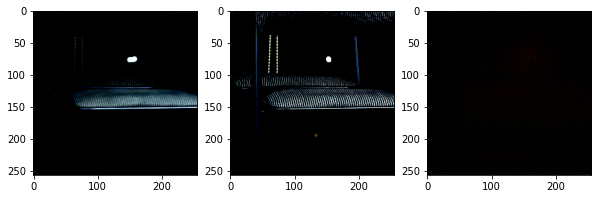

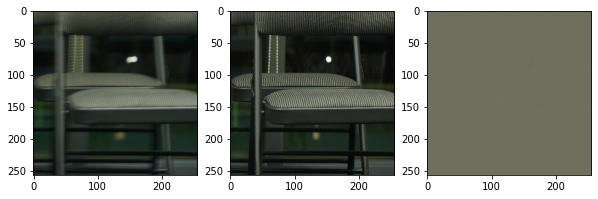

---- -2.811304e-08 ,, 0.98039216
=====
This is epoch 1
And the PSNR is 17.020387913766022
And the images are...


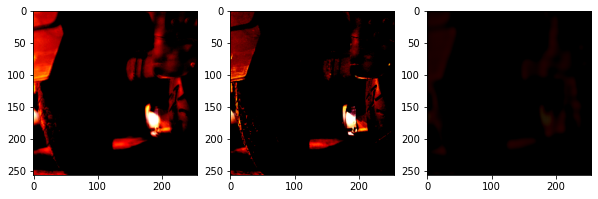

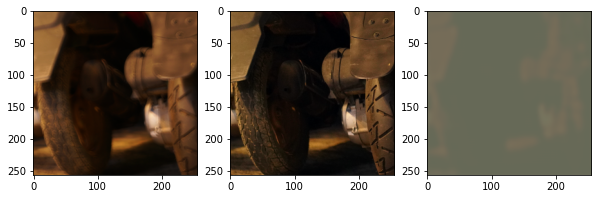

---- -2.811304e-08 ,, 1.0
=====
This is epoch 2
And the PSNR is 15.521157871310894
And the images are...


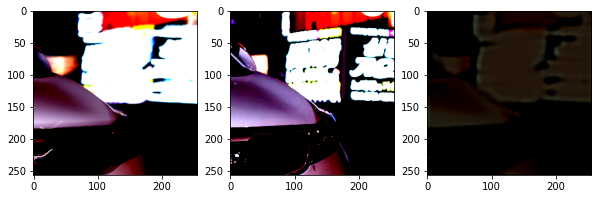

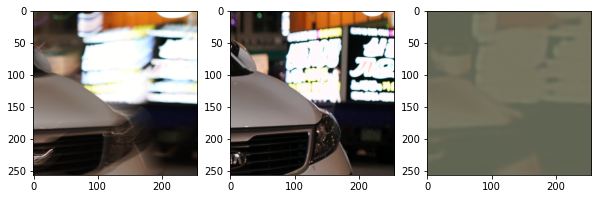

---- 0.039215665 ,, 0.96862745
=====
This is epoch 3
And the PSNR is 12.789235877129437
And the images are...


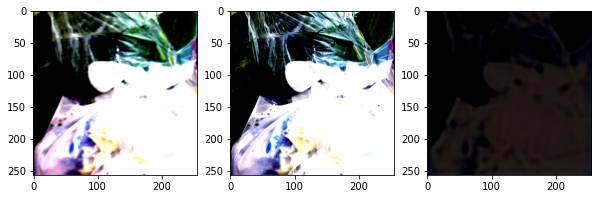

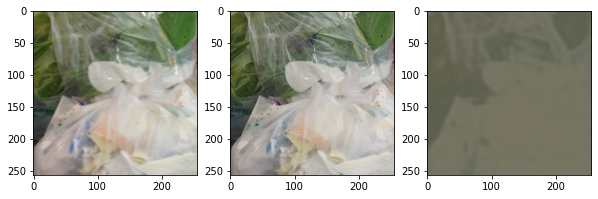

---- 0.0078431275 ,, 0.87058824
=====
This is epoch 4
And the PSNR is 15.611564837636413
And the images are...


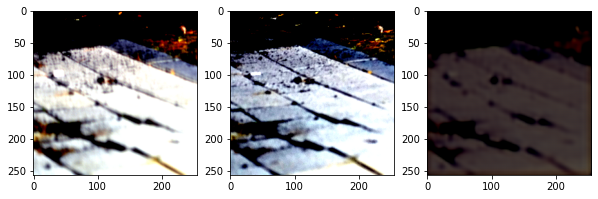

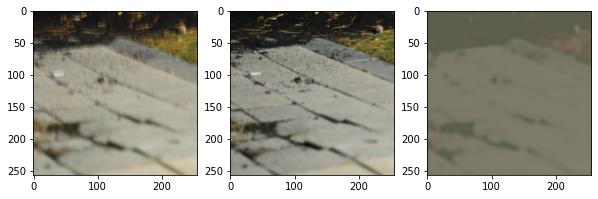

---- -2.811304e-08 ,, 0.98039216
=====
This is epoch 5
And the PSNR is 17.9398046340301
And the images are...


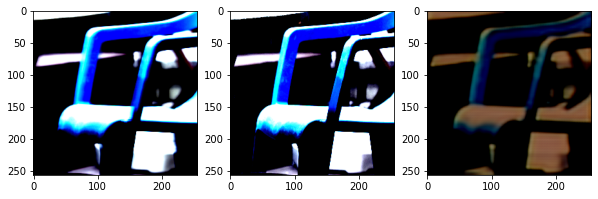

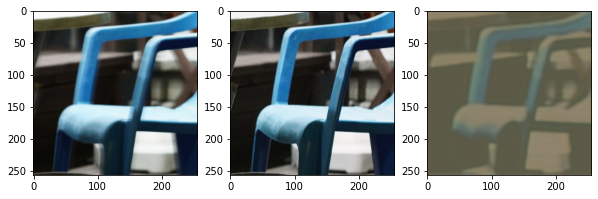

---- -2.811304e-08 ,, 0.85882354
=====
This is epoch 6
And the PSNR is 18.924454557971533
And the images are...


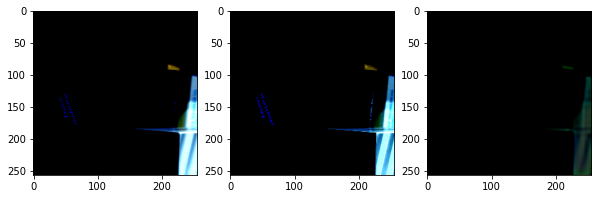

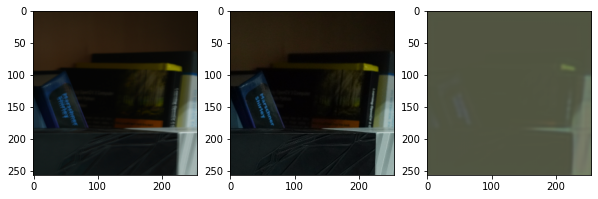

---- -2.811304e-08 ,, 1.0
=====
This is epoch 7
And the PSNR is 18.485778158357636
And the images are...


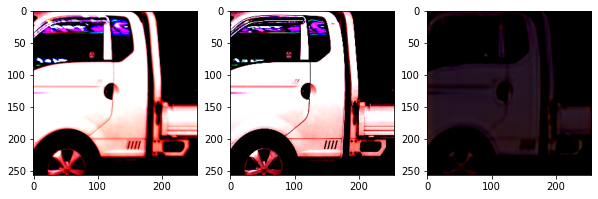

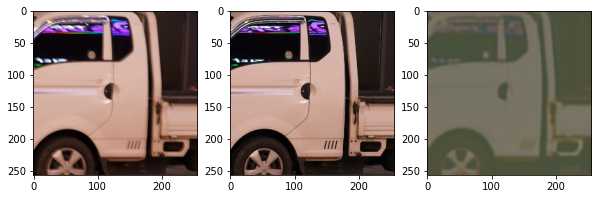

---- -2.811304e-08 ,, 0.78823525
=====
This is epoch 8
And the PSNR is 18.42358544247768
And the images are...


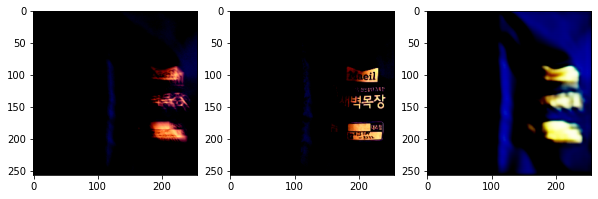

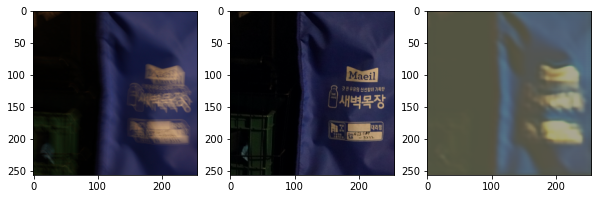

---- 0.015686255 ,, 0.8745098
=====
This is epoch 9
And the PSNR is 20.553914758405384
And the images are...


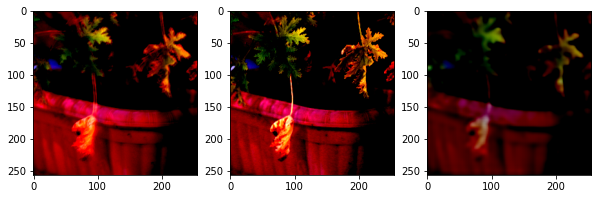

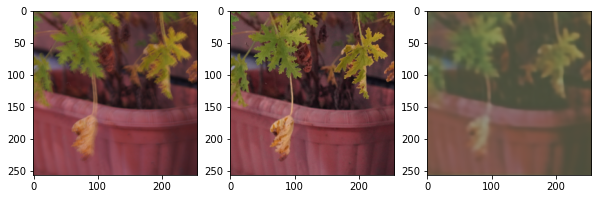

---- 0.17254901 ,, 0.97647053
=====
This is epoch 10
And the PSNR is 12.467600764424924
And the images are...


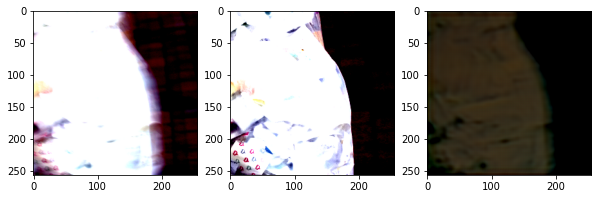

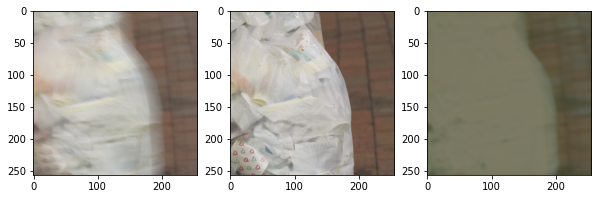

---- 0.007843117 ,, 0.9960784
=====
This is epoch 11
And the PSNR is 13.163791561013303
And the images are...


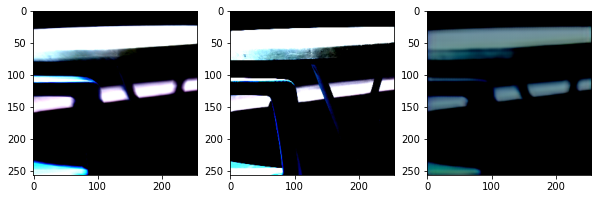

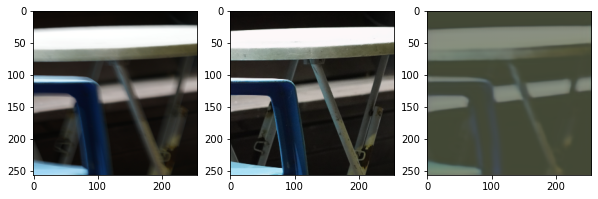

---- 0.0 ,, 0.9490196
=====
This is epoch 12
And the PSNR is 19.110064035977835
And the images are...


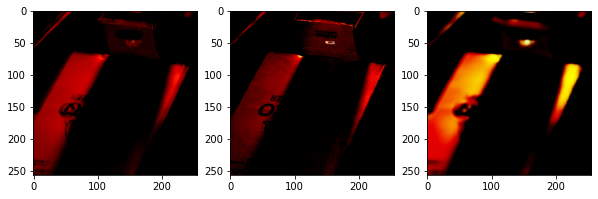

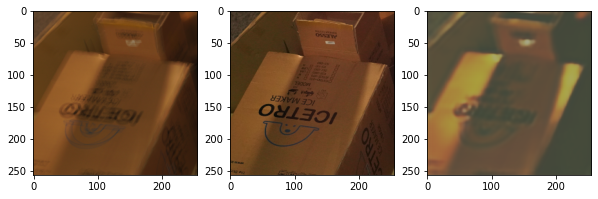

---- -2.811304e-08 ,, 0.9921568
=====
This is epoch 13
And the PSNR is 23.25743923375682
And the images are...


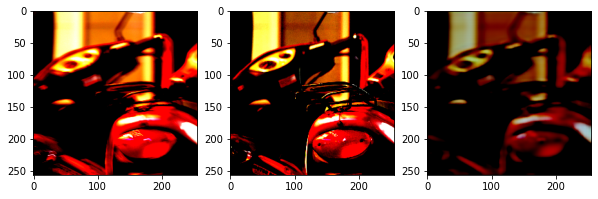

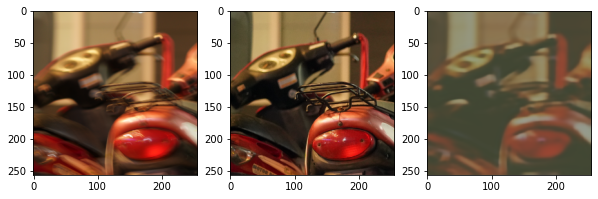

---- -2.811304e-08 ,, 0.9647058
=====
This is epoch 14
And the PSNR is 22.982825635011025
And the images are...


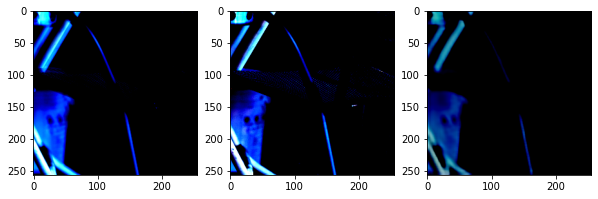

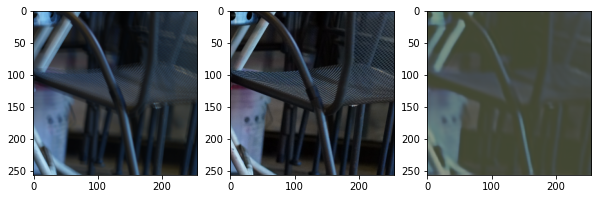

---- -2.811304e-08 ,, 0.6431373
=====
This is epoch 15
And the PSNR is 30.43233973997654
And the images are...


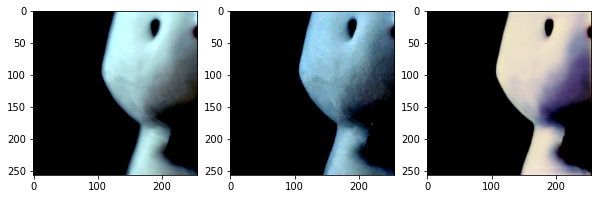

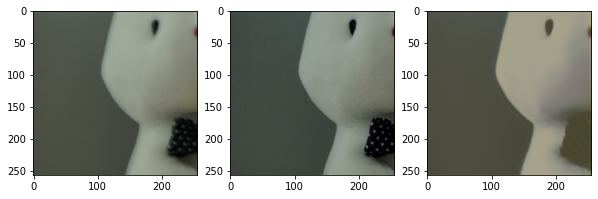

---- -2.811304e-08 ,, 0.97254896
=====
This is epoch 16
And the PSNR is 24.88256508987461
And the images are...


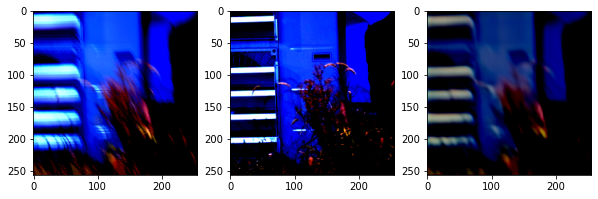

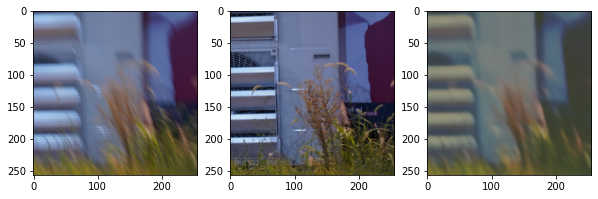

---- -2.6311284e-08 ,, 1.0
=====
This is epoch 17
And the PSNR is 23.653094513796546
And the images are...


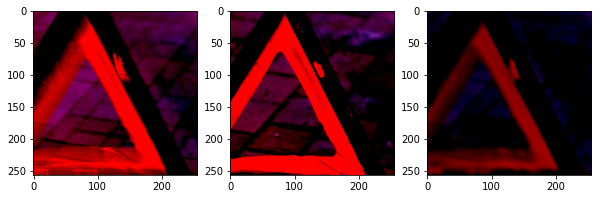

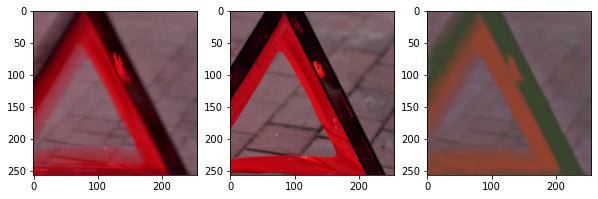

---- -2.811304e-08 ,, 0.6941176
=====
This is epoch 18
And the PSNR is 24.881072967620874
And the images are...


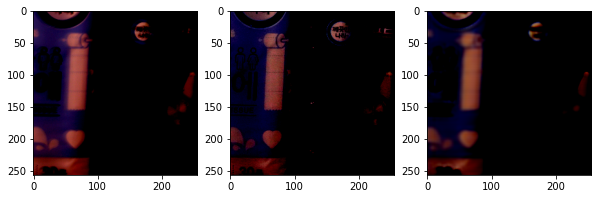

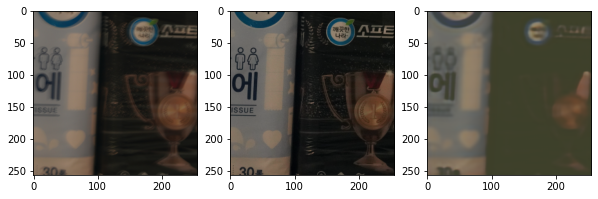

---- -2.811304e-08 ,, 0.8901961
=====
This is epoch 19
And the PSNR is 25.321516305337003
And the images are...


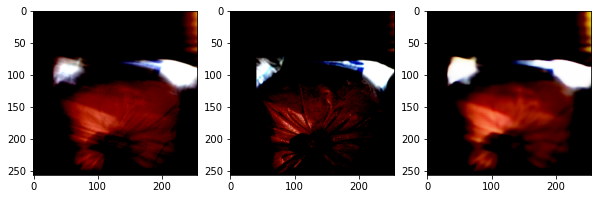

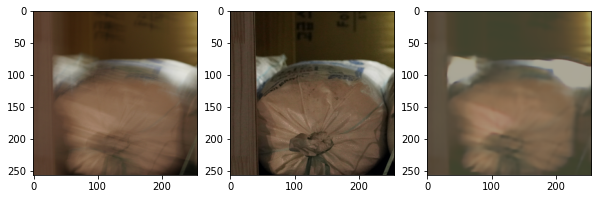

---- -2.811304e-08 ,, 0.9921568
=====
This is epoch 20
And the PSNR is 21.73775950284044
And the images are...


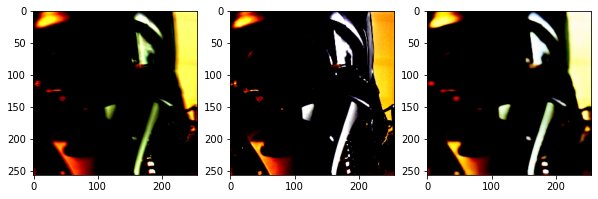

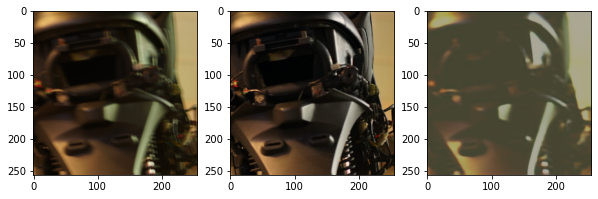

---- -2.811304e-08 ,, 1.0
=====
This is epoch 21
And the PSNR is 20.686446014484172
And the images are...


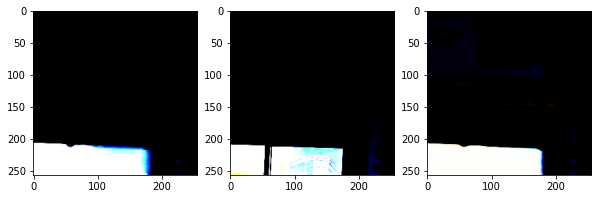

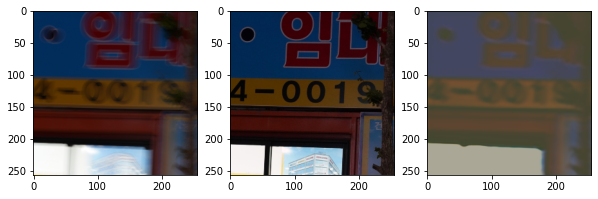

---- 0.0 ,, 0.8235295
=====
This is epoch 22
And the PSNR is 18.637846098808378
And the images are...


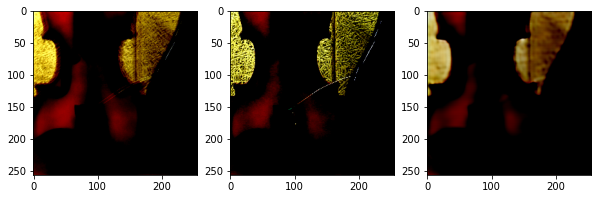

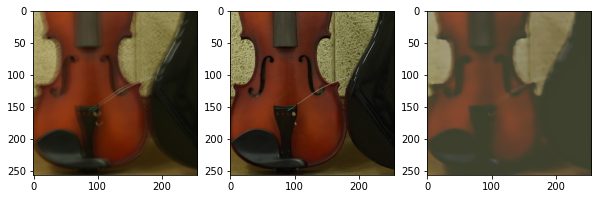

---- -2.811304e-08 ,, 0.83137244
=====
This is epoch 23
And the PSNR is 26.72923809772954
And the images are...


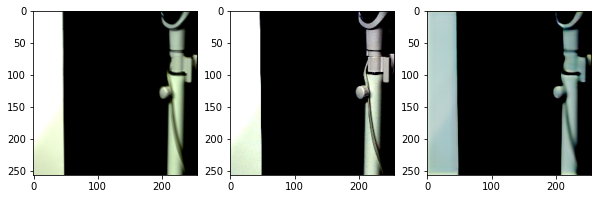

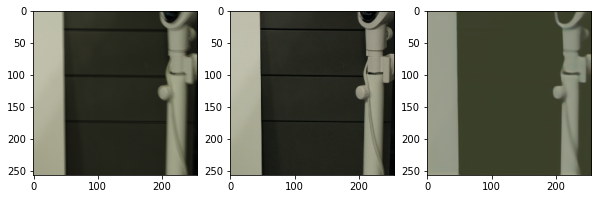

---- -2.811304e-08 ,, 0.63529414
=====
This is epoch 24
And the PSNR is 30.391466287512152
And the images are...


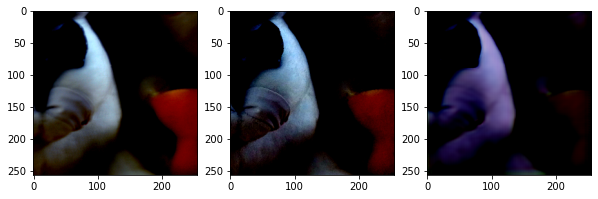

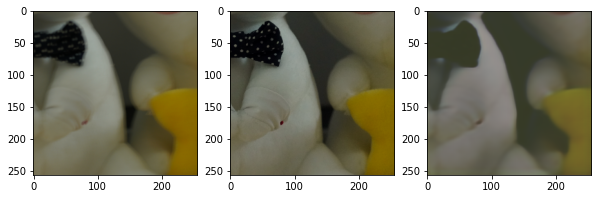

---- 0.0 ,, 0.86274505
=====
This is epoch 25
And the PSNR is 23.298020124029833
And the images are...


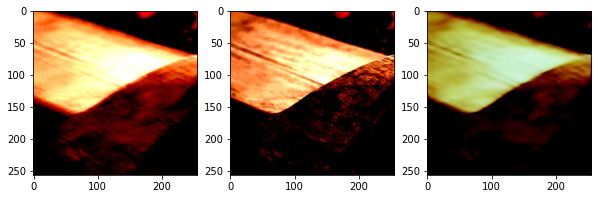

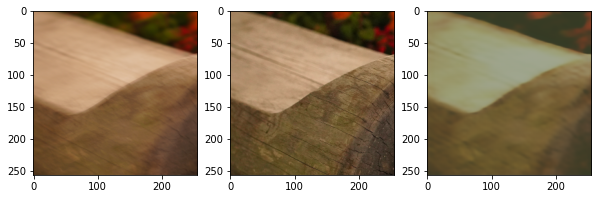

---- 0.019607833 ,, 0.9999999
=====
This is epoch 26
And the PSNR is 21.586695261609755
And the images are...


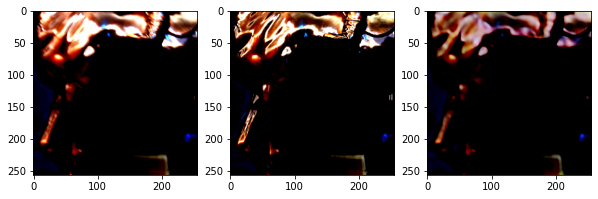

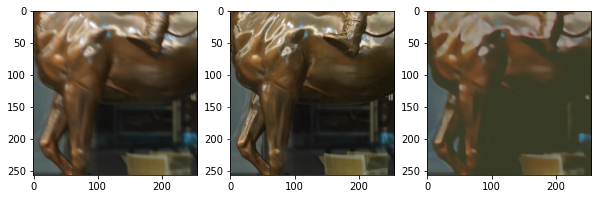

---- 0.003921544 ,, 0.86666673
=====
This is epoch 27
And the PSNR is 22.476209698974362
And the images are...


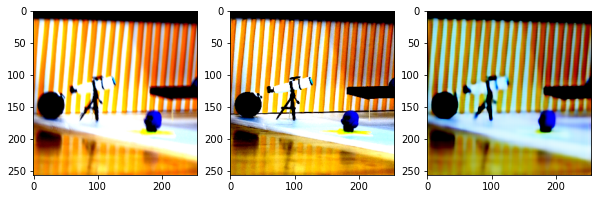

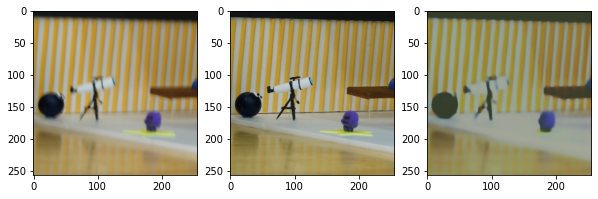

---- -2.811304e-08 ,, 0.980392
=====
This is epoch 28
And the PSNR is 26.456057535558017
And the images are...


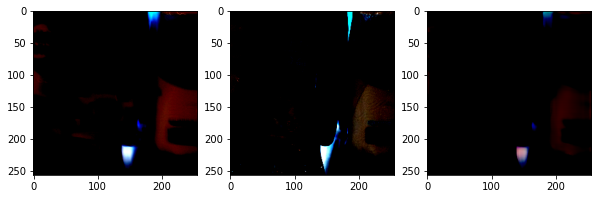

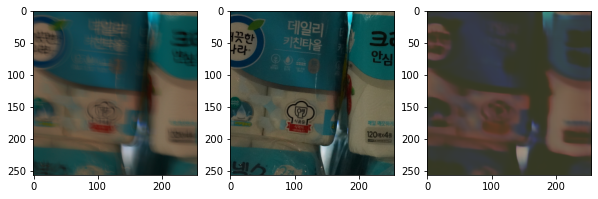

---- -2.811304e-08 ,, 0.7568627
=====
This is epoch 29
And the PSNR is 24.831502763044263
And the images are...


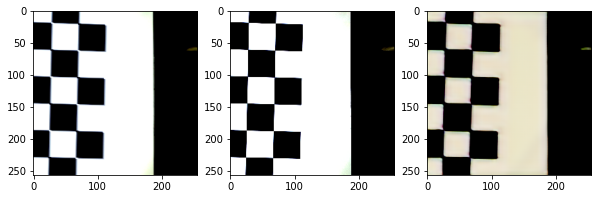

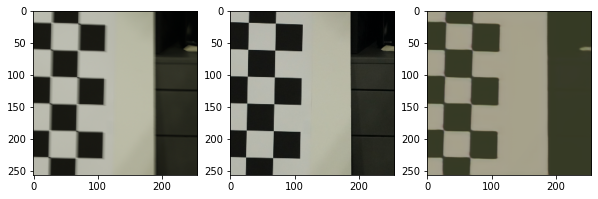

---- 0.0 ,, 1.0
=====
This is epoch 30
And the PSNR is 15.549017823032134
And the images are...


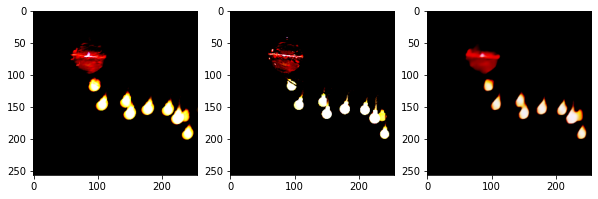

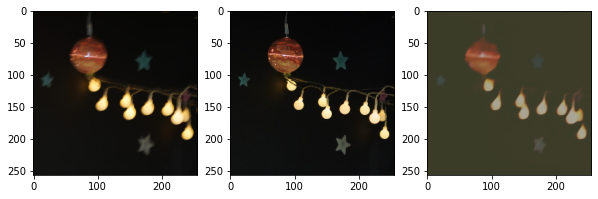

---- -2.811304e-08 ,, 0.82352936
=====
This is epoch 31
And the PSNR is 26.871955271109805
And the images are...


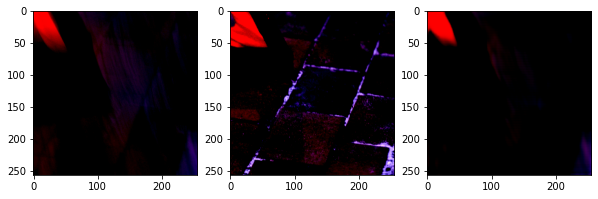

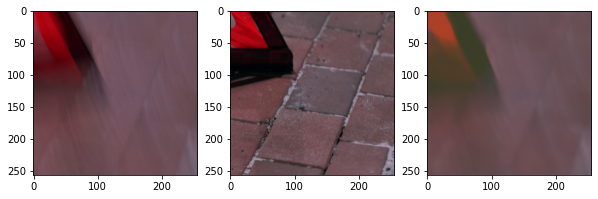

---- -2.811304e-08 ,, 0.6392157
=====
This is epoch 32
And the PSNR is 29.725779360170094
And the images are...


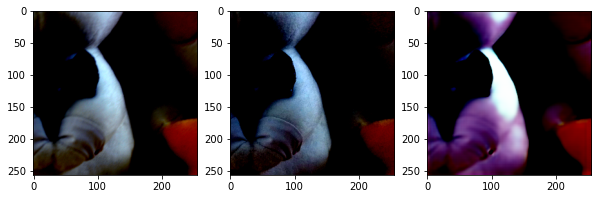

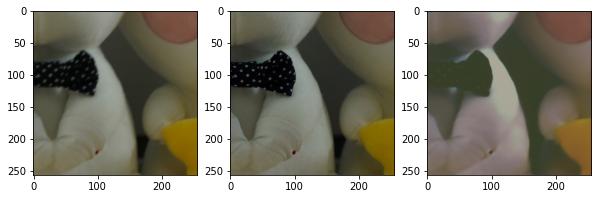

---- 0.0 ,, 0.8156863
=====
This is epoch 33
And the PSNR is 22.292662790626103
And the images are...


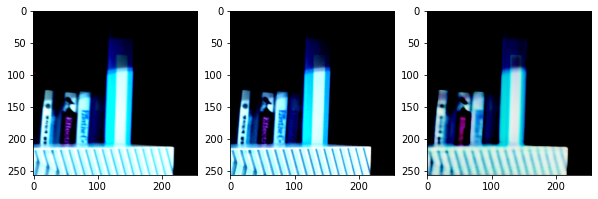

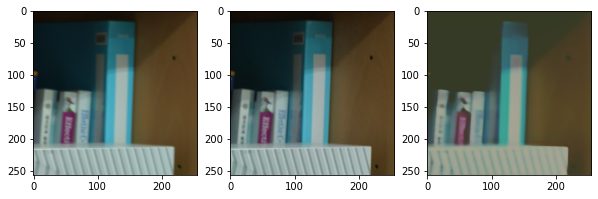

---- -2.6311284e-08 ,, 1.0
=====
This is epoch 34
And the PSNR is 25.591933503919012
And the images are...


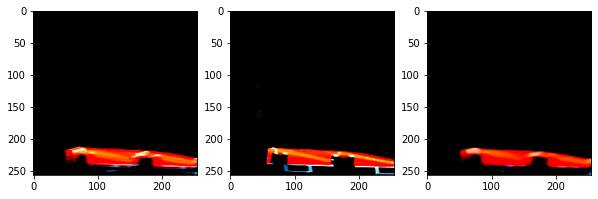

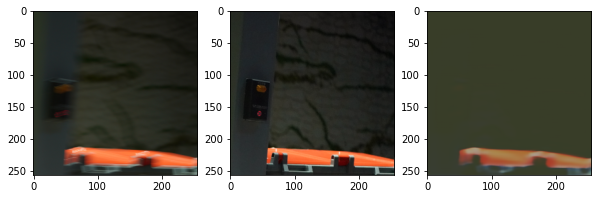

---- 0.007843117 ,, 0.9490196
=====
This is epoch 35
And the PSNR is 17.92134935482362
And the images are...


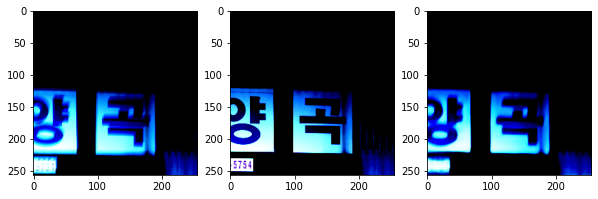

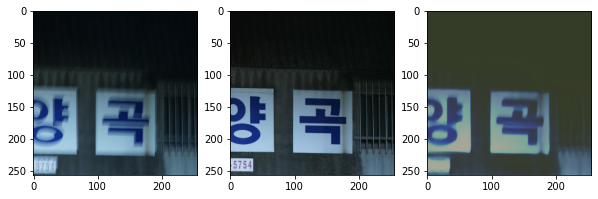

---- 0.0 ,, 0.7490196
=====
This is epoch 36
And the PSNR is 19.20164166697973
And the images are...


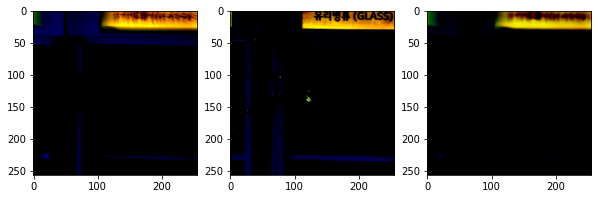

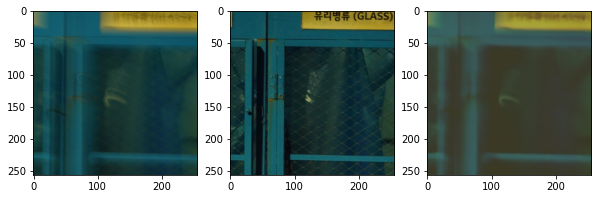

---- 0.03137252 ,, 1.0
=====
This is epoch 37
And the PSNR is 28.558594800484173
And the images are...


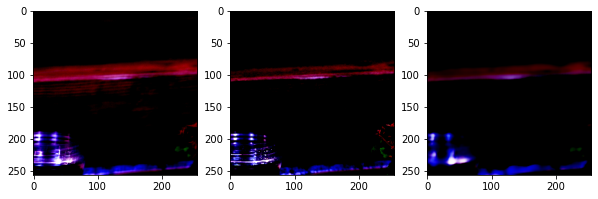

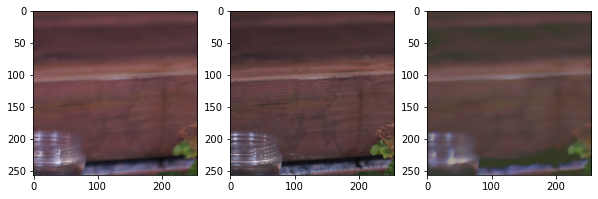

---- 0.0 ,, 1.0
=====
This is epoch 38
And the PSNR is 14.814026659002028
And the images are...


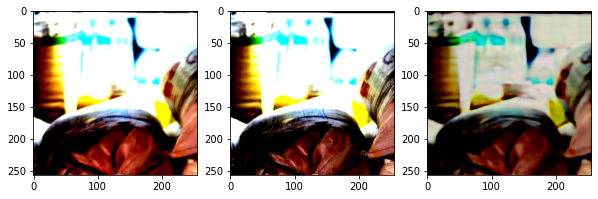

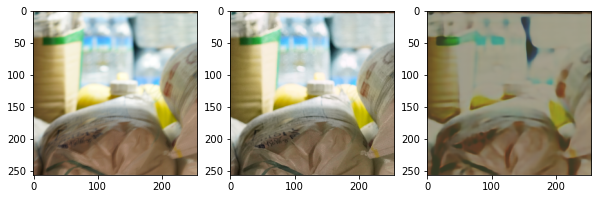

---- -2.811304e-08 ,, 0.9921568
=====
This is epoch 39
And the PSNR is 25.517377772292477
And the images are...


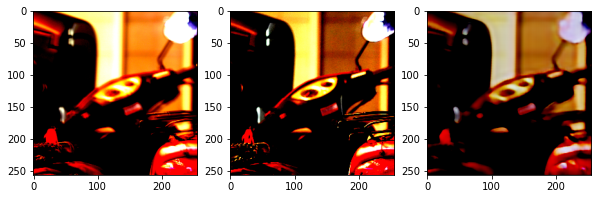

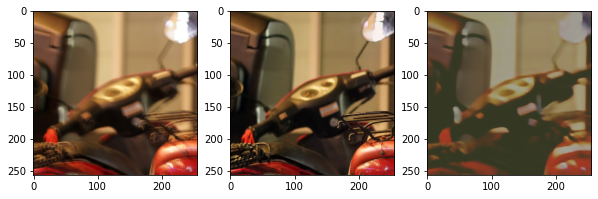

---- 0.0 ,, 1.0
=====
This is epoch 40
And the PSNR is 17.461921157906325
And the images are...


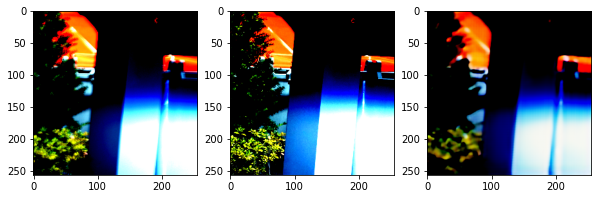

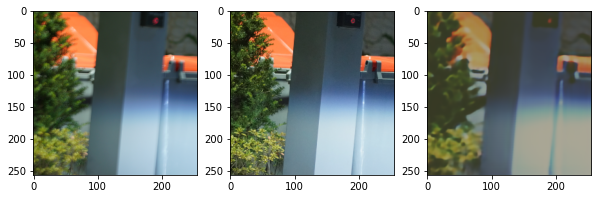

---- 0.011764689 ,, 0.7843137
=====
This is epoch 41
And the PSNR is 23.2303418209449
And the images are...


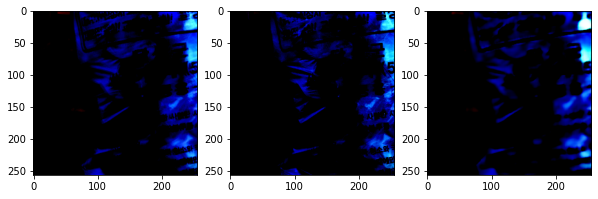

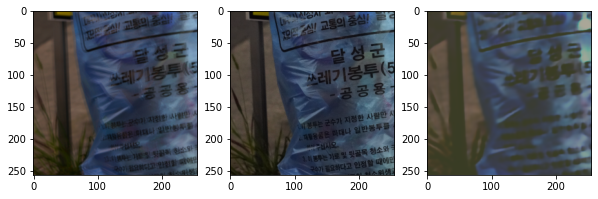

---- -2.811304e-08 ,, 1.0
=====
This is epoch 42
And the PSNR is 23.85726912610223
And the images are...


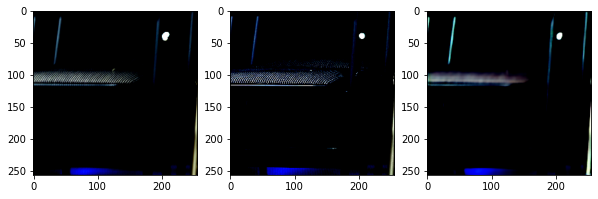

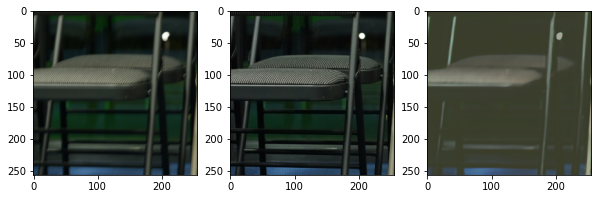

---- -2.811304e-08 ,, 1.0
=====
This is epoch 43
And the PSNR is 26.088853100160946
And the images are...


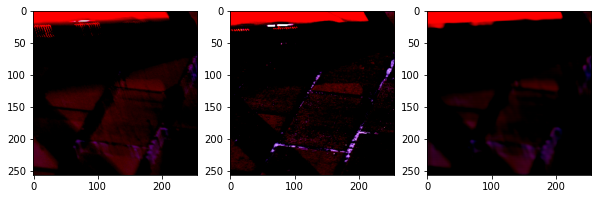

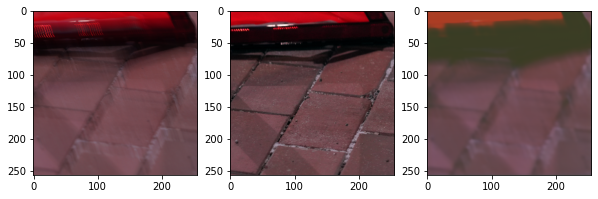

---- 0.0078431275 ,, 1.0
=====
This is epoch 44
And the PSNR is 18.153308251573176
And the images are...


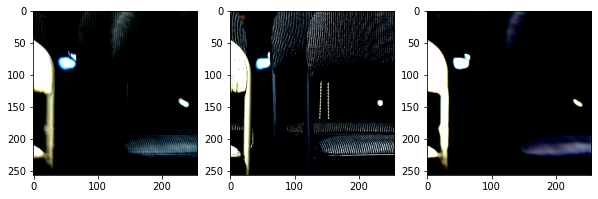

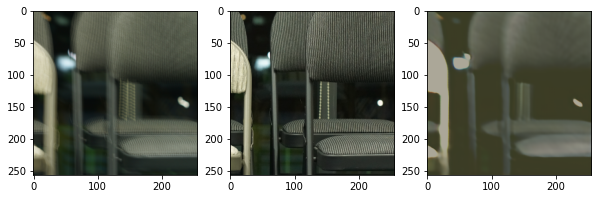

---- -2.811304e-08 ,, 1.0
=====
This is epoch 45
And the PSNR is 22.19920682614573
And the images are...


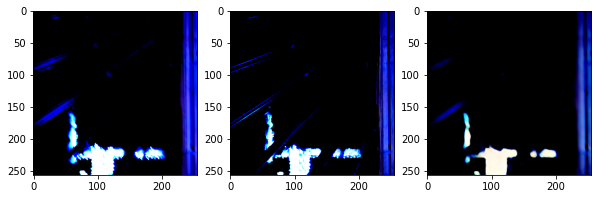

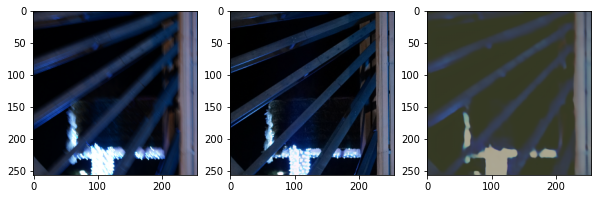

---- -2.811304e-08 ,, 0.96470577
=====
This is epoch 46
And the PSNR is 24.235846339249214
And the images are...


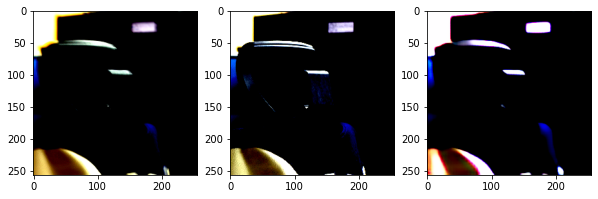

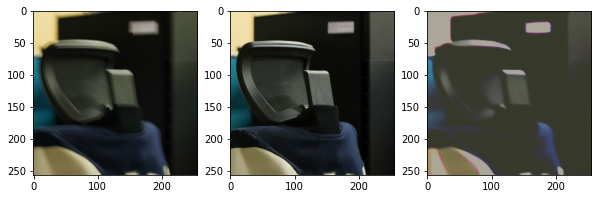

---- -2.811304e-08 ,, 0.9568627
=====
This is epoch 47
And the PSNR is 30.435532034783748
And the images are...


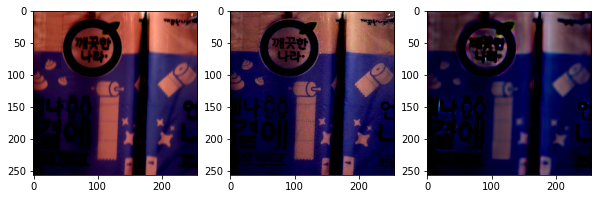

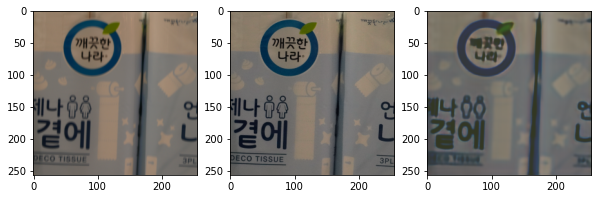

---- 0.0 ,, 0.8078431
=====
This is epoch 48
And the PSNR is 20.69729143215346
And the images are...


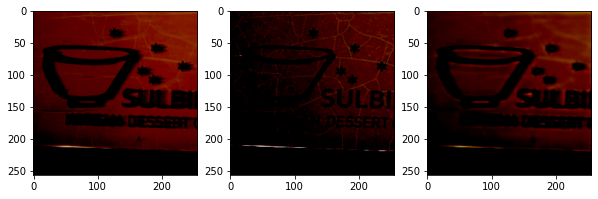

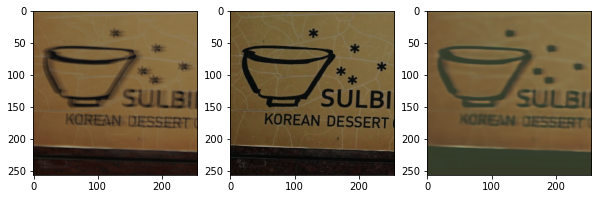

---- -2.811304e-08 ,, 0.81960785
=====
This is epoch 49
And the PSNR is 30.79035857823432
And the images are...


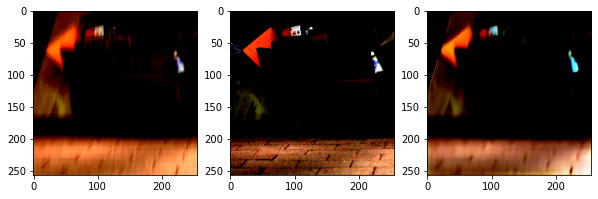

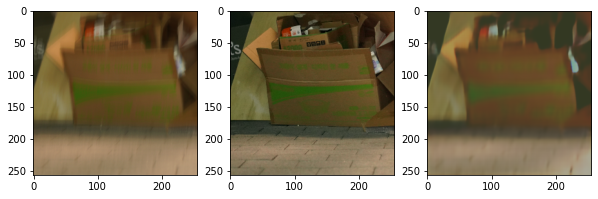

---- -2.811304e-08 ,, 0.97647053
=====
This is epoch 50
And the PSNR is 28.134596916881904
And the images are...


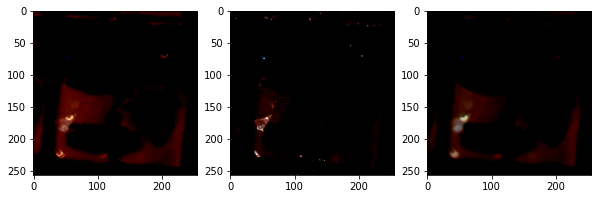

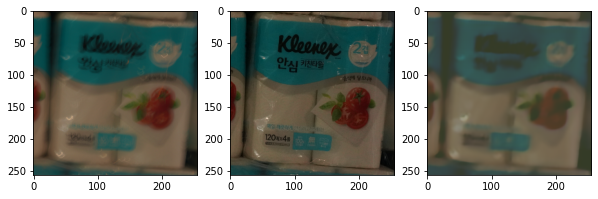

---- 0.04313724 ,, 0.70980394
=====
This is epoch 51
And the PSNR is 22.90894053902141
And the images are...


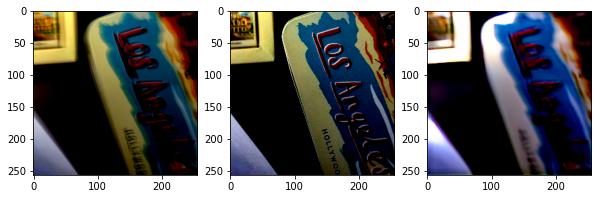

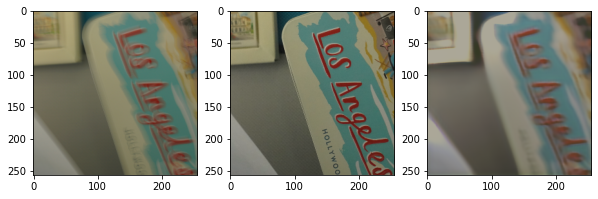

---- 0.003921565 ,, 0.9647058
=====
This is epoch 52
And the PSNR is 15.05007197787692
And the images are...


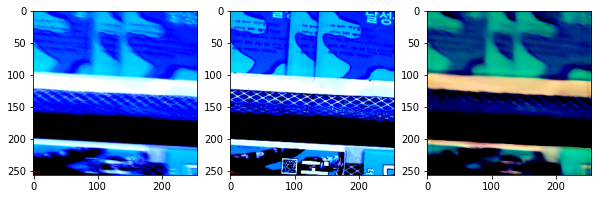

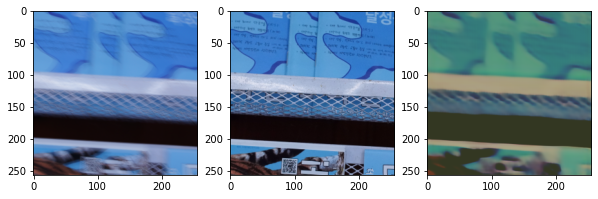

---- -2.6311284e-08 ,, 0.9999999
=====
This is epoch 53
And the PSNR is 25.1299092806012
And the images are...


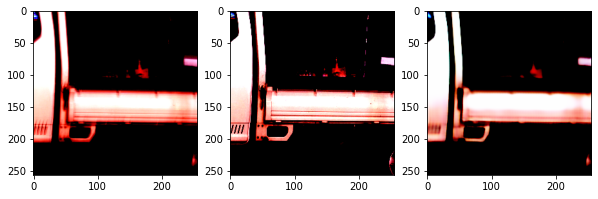

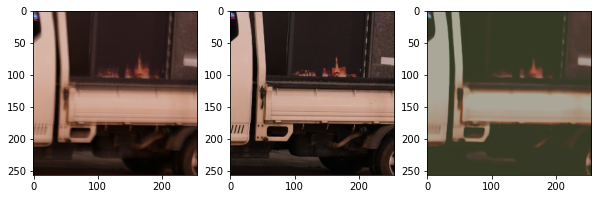

---- -2.6311284e-08 ,, 0.65098035
=====
This is epoch 54
And the PSNR is 29.20117082017777
And the images are...


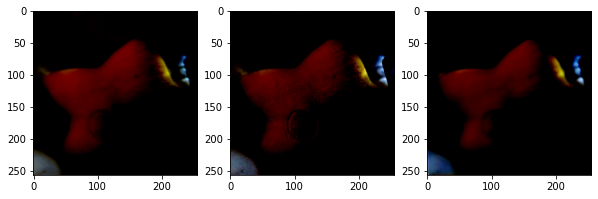

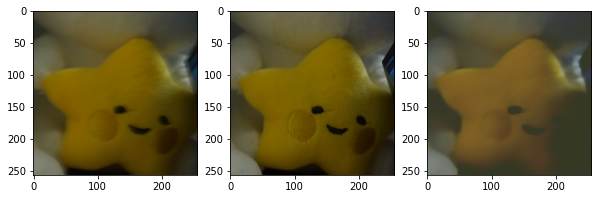

---- -2.811304e-08 ,, 1.0
=====
This is epoch 55
And the PSNR is 26.631658560587876
And the images are...


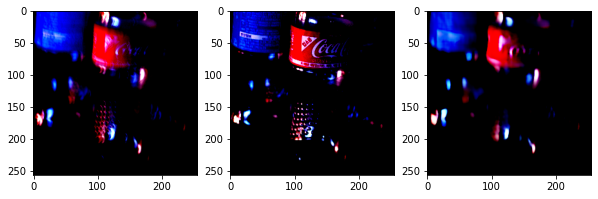

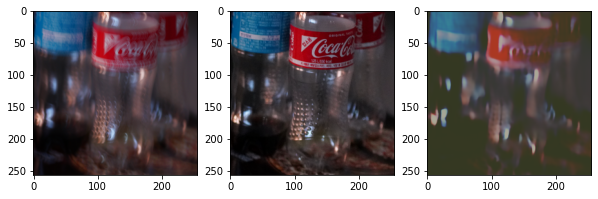

---- -2.811304e-08 ,, 0.9803922
=====
This is epoch 56
And the PSNR is 26.156523662919412
And the images are...


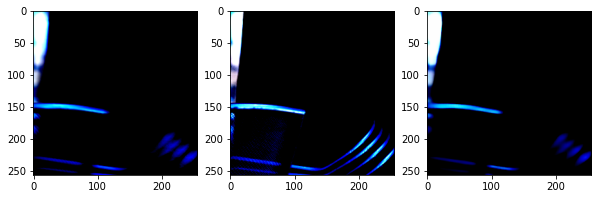

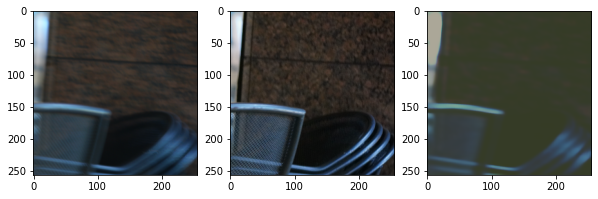

---- 0.011764705 ,, 0.9686274
=====
This is epoch 57
And the PSNR is 18.549781382564937
And the images are...


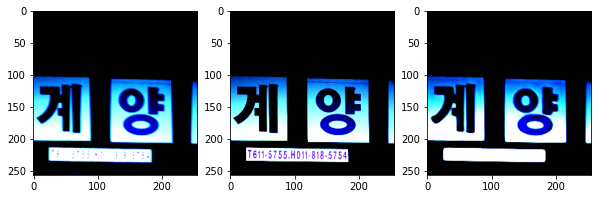

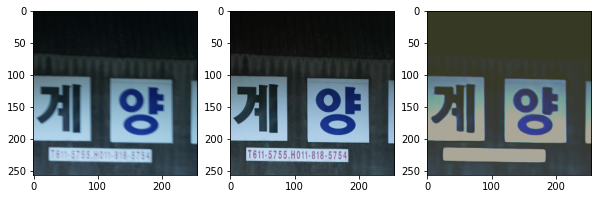

---- -2.811304e-08 ,, 0.9960784
=====
This is epoch 58
And the PSNR is 25.40101956872194
And the images are...


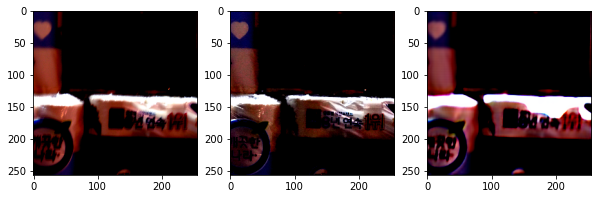

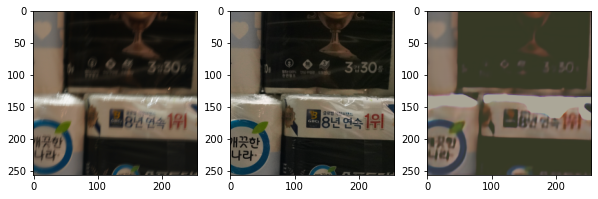

---- -2.6311284e-08 ,, 1.0
=====
This is epoch 59
And the PSNR is 27.467369908382228
And the images are...


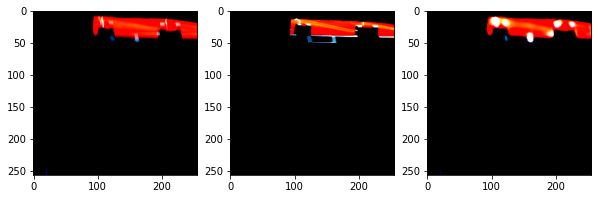

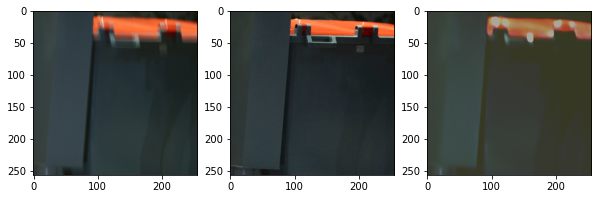

---- -2.811304e-08 ,, 0.7764706
=====
This is epoch 60
And the PSNR is 31.48598974617501
And the images are...


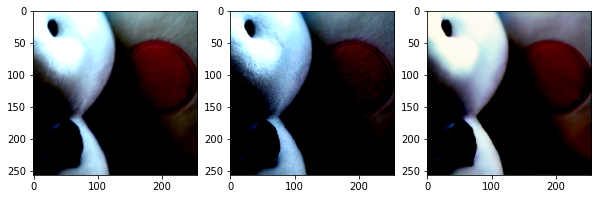

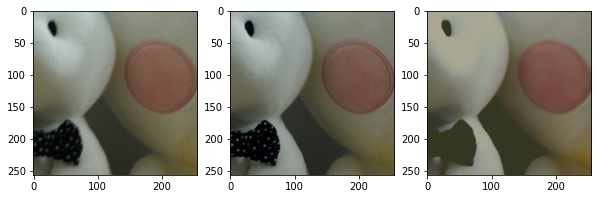

---- -2.811304e-08 ,, 0.98431367
=====
This is epoch 61
And the PSNR is 21.43251368075577
And the images are...


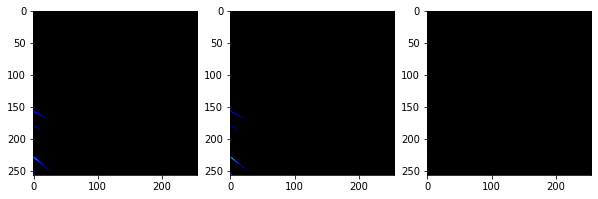

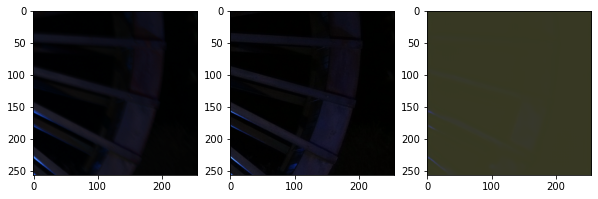

---- 0.0 ,, 0.86666673
=====
This is epoch 62
And the PSNR is 21.22287522252812
And the images are...


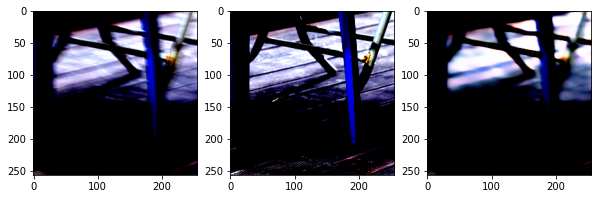

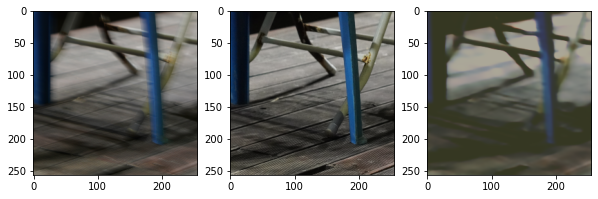

---- -2.6311284e-08 ,, 1.0
=====
This is epoch 63
And the PSNR is 24.98691433509247
And the images are...


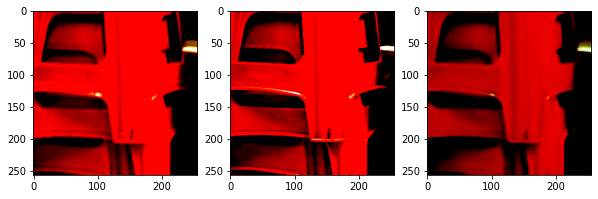

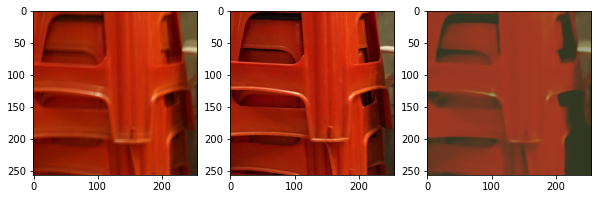

---- -2.811304e-08 ,, 0.58823526
=====
This is epoch 64
And the PSNR is 28.281153582337765
And the images are...


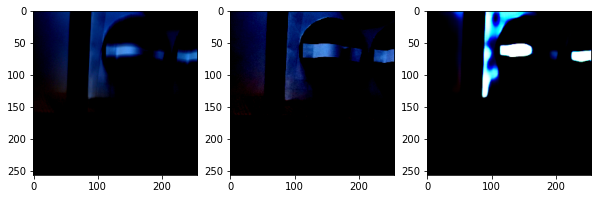

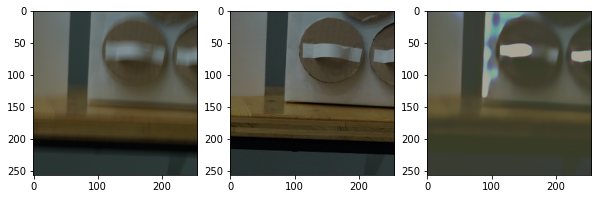

---- 0.003921544 ,, 0.98823524
=====
This is epoch 65
And the PSNR is 18.70731090691506
And the images are...


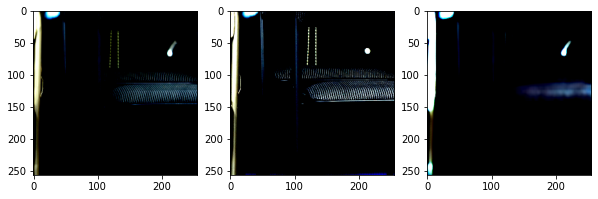

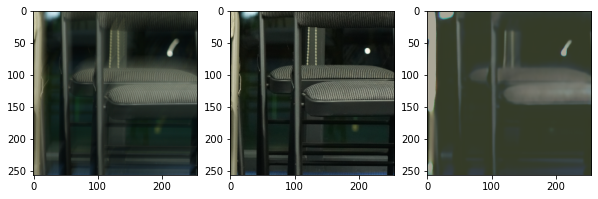

---- 0.0 ,, 0.8039216
=====
This is epoch 66
And the PSNR is 23.8821699374531
And the images are...


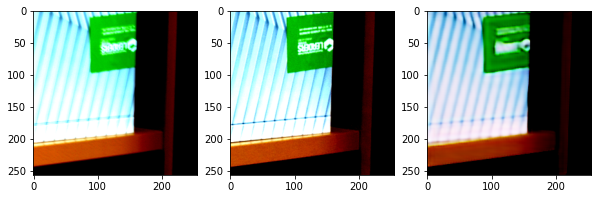

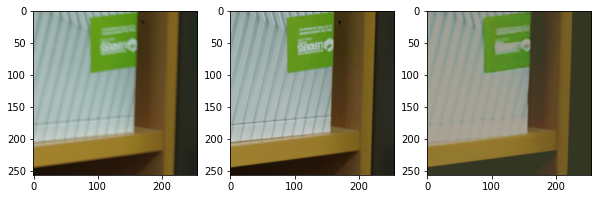

---- -2.6311284e-08 ,, 0.6156863
=====
This is epoch 67
And the PSNR is 29.057491361665747
And the images are...


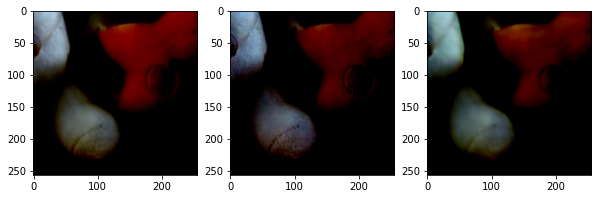

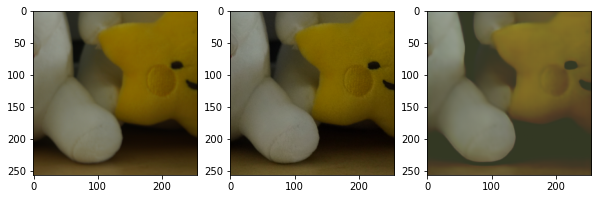

---- -2.811304e-08 ,, 1.0
=====
This is epoch 68
And the PSNR is 23.11308589422234
And the images are...


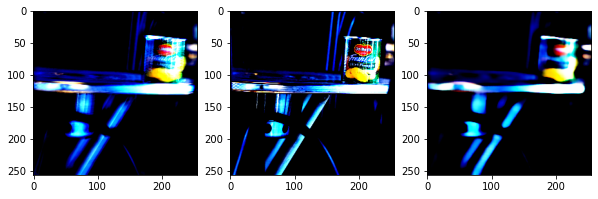

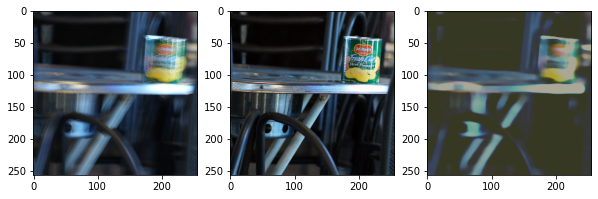

---- 0.0 ,, 0.890196
=====
This is epoch 69
And the PSNR is 21.216858975766122
And the images are...


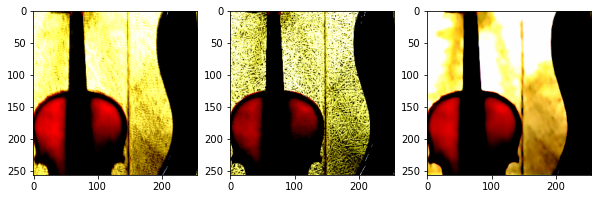

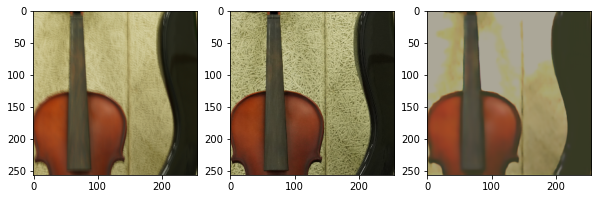

---- 0.0 ,, 0.86274505
=====
This is epoch 70
And the PSNR is 23.056071445607664
And the images are...


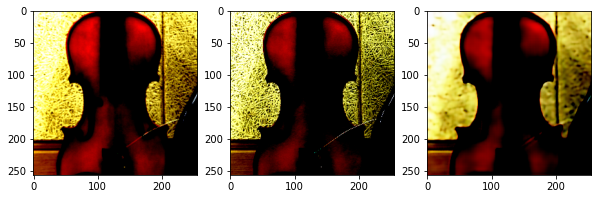

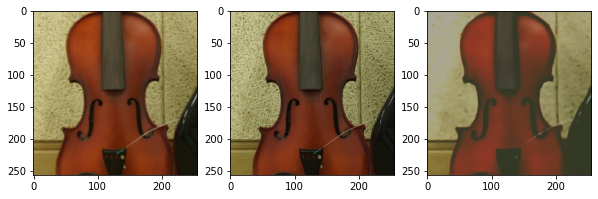

---- 0.05098036 ,, 0.75294113
=====
This is epoch 71
And the PSNR is 25.251510625467827
And the images are...


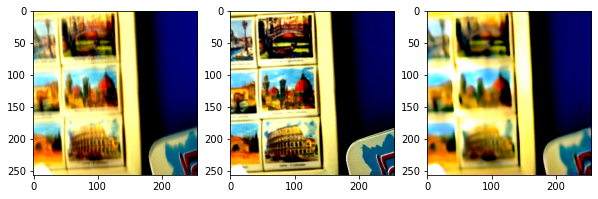

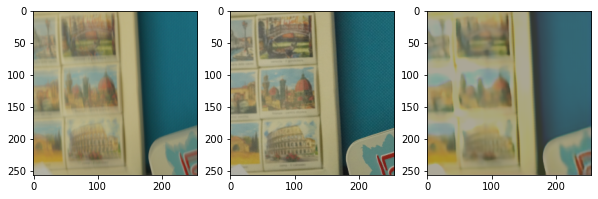

---- 0.007843117 ,, 0.5686274
=====
This is epoch 72
And the PSNR is 20.82887309597932
And the images are...


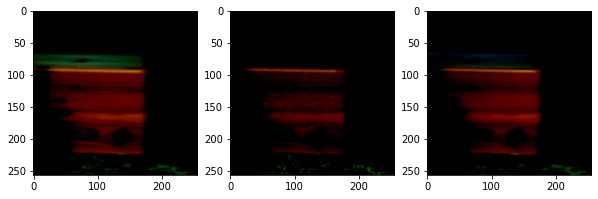

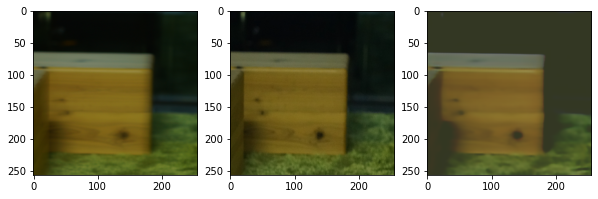

---- -2.811304e-08 ,, 0.91764706
=====
This is epoch 73
And the PSNR is 27.806693435577774
And the images are...


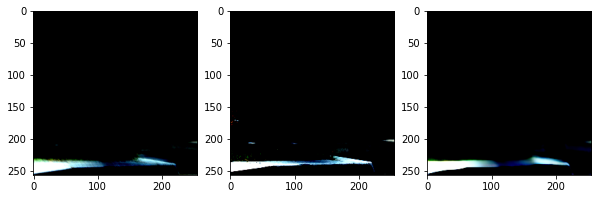

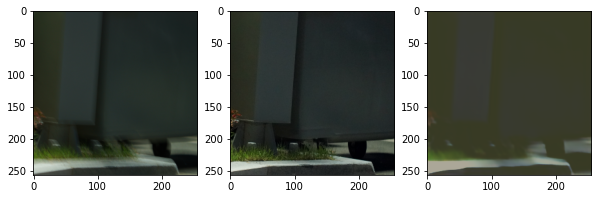

---- -2.811304e-08 ,, 0.9490196
=====
This is epoch 74
And the PSNR is 25.161041228597153
And the images are...


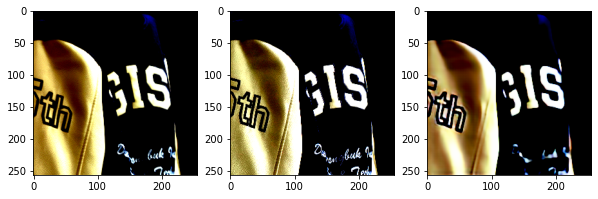

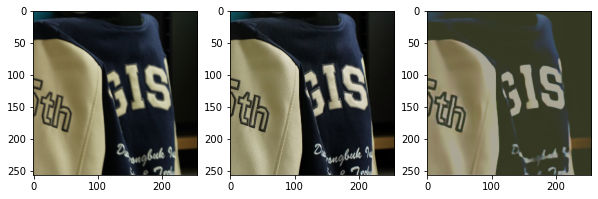

---- 0.03137254 ,, 0.83137244
=====
This is epoch 75
And the PSNR is 24.60934654727773
And the images are...


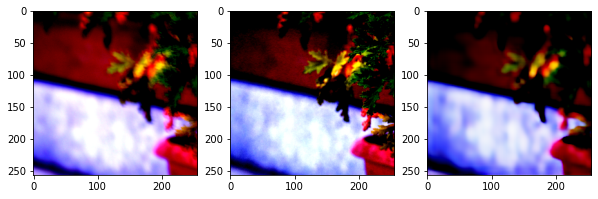

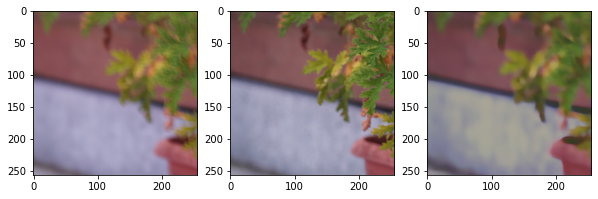

---- 0.023529379 ,, 0.9647058
=====
This is epoch 76
And the PSNR is 17.91055942175339
And the images are...


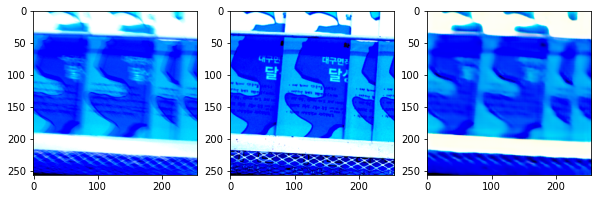

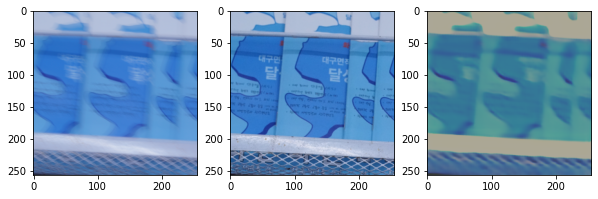

---- -2.811304e-08 ,, 0.89803916
=====
This is epoch 77
And the PSNR is 25.532110400584532
And the images are...


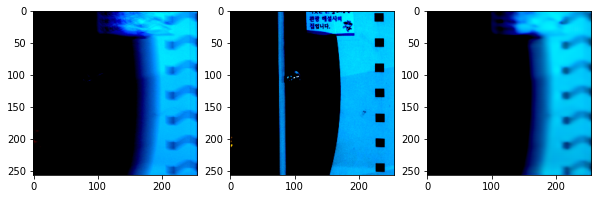

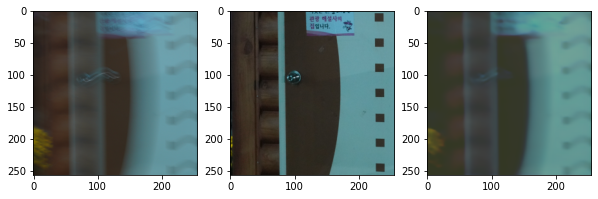

---- 0.0 ,, 0.90196073
=====
This is epoch 78
And the PSNR is 21.302736359032824
And the images are...


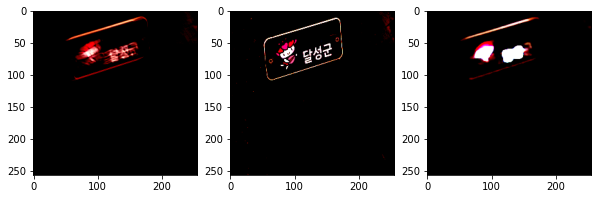

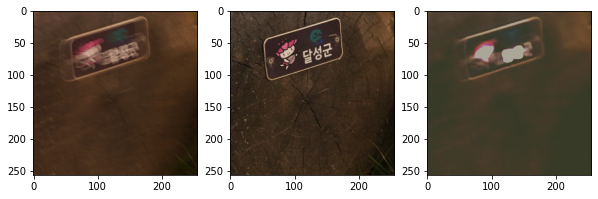

---- -2.6311284e-08 ,, 0.9921568
=====
This is epoch 79
And the PSNR is 26.090666032606155
And the images are...


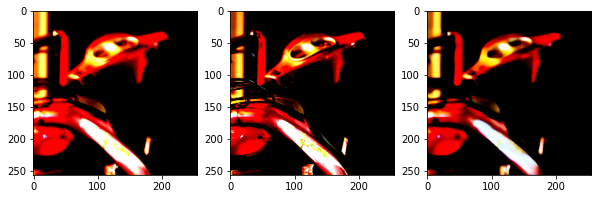

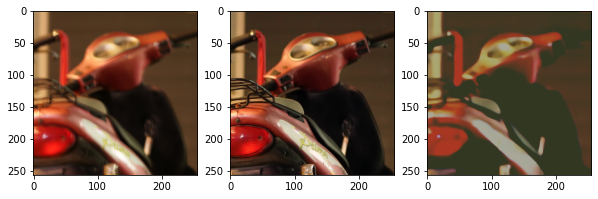

---- 0.015686262 ,, 0.97254896
=====
This is epoch 80
And the PSNR is 20.8245690401112
And the images are...


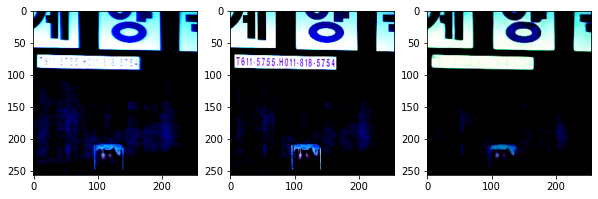

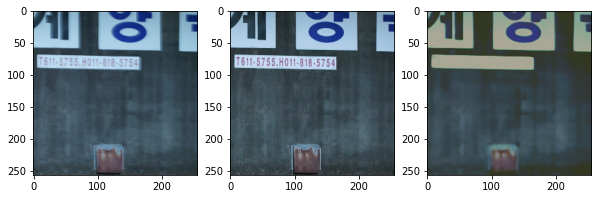

---- -2.811304e-08 ,, 0.71372557
=====
This is epoch 81
And the PSNR is 21.3846474320286
And the images are...


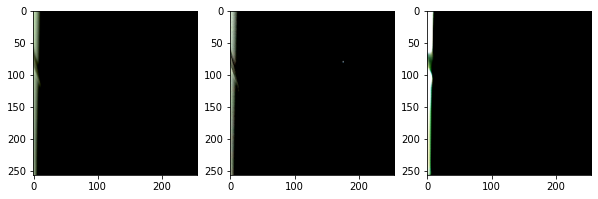

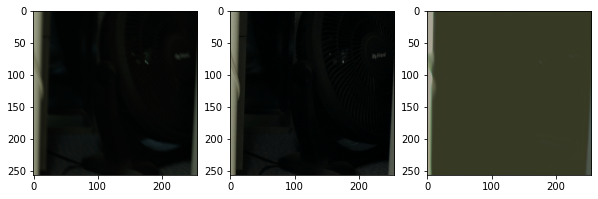

---- -2.811304e-08 ,, 1.0
=====
This is epoch 82
And the PSNR is 30.50793907733305
And the images are...


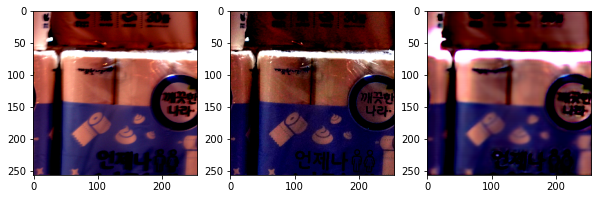

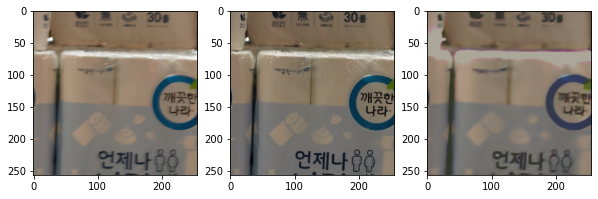

---- -2.811304e-08 ,, 0.9921568
=====
This is epoch 83
And the PSNR is 25.23650788876325
And the images are...


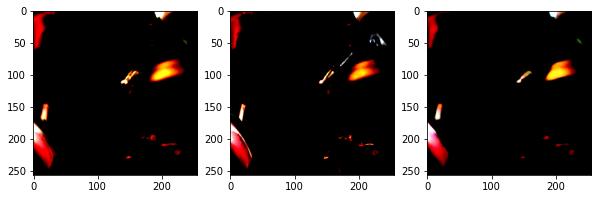

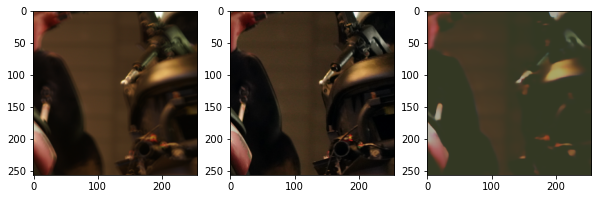

---- -2.6311284e-08 ,, 0.9882352
=====
This is epoch 84
And the PSNR is 33.07871946484671
And the images are...


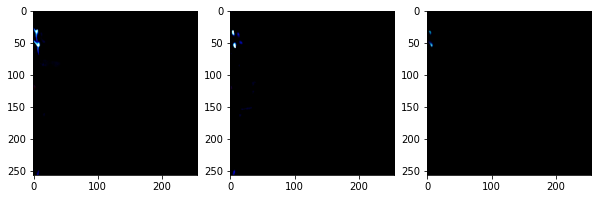

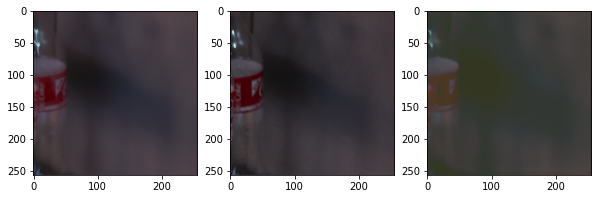

---- 0.12941176 ,, 0.8784313
=====
This is epoch 85
And the PSNR is 21.302633337606252
And the images are...


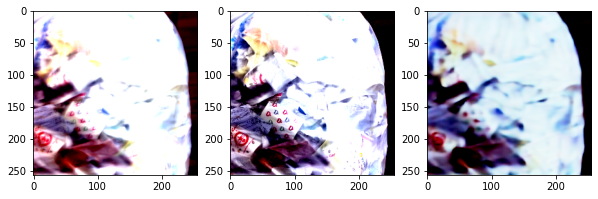

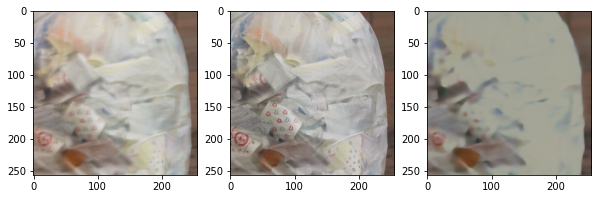

---- -2.811304e-08 ,, 0.98823524
=====
This is epoch 86
And the PSNR is 21.951530089539993
And the images are...


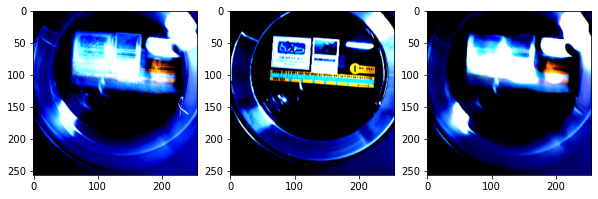

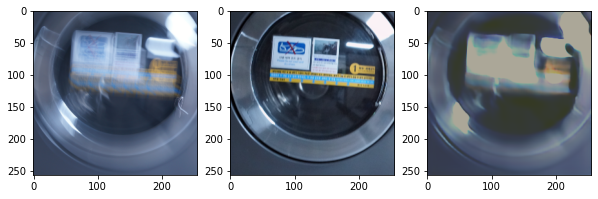

---- -2.6311284e-08 ,, 1.0
=====
This is epoch 87
And the PSNR is 23.208708149154873
And the images are...


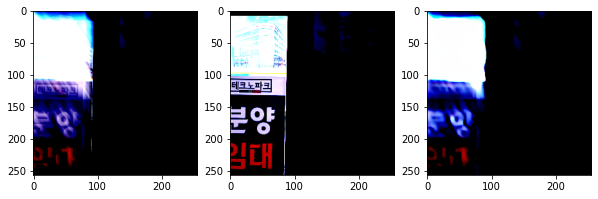

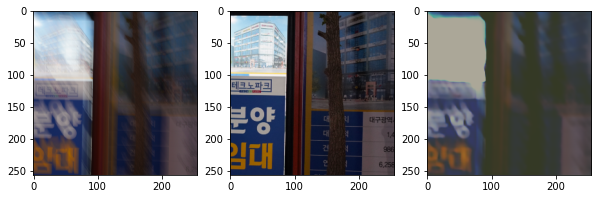

---- 0.0 ,, 0.9333333
=====
This is epoch 88
And the PSNR is 23.37240091419837
And the images are...


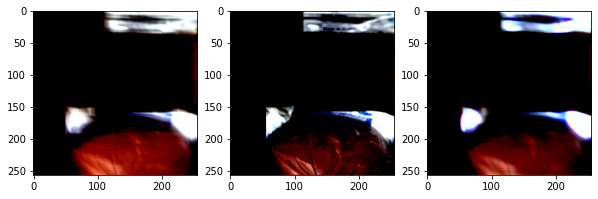

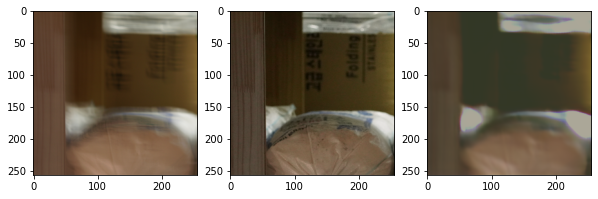

---- 0.015686255 ,, 0.9960783
=====
This is epoch 89
And the PSNR is 19.099708586657165
And the images are...


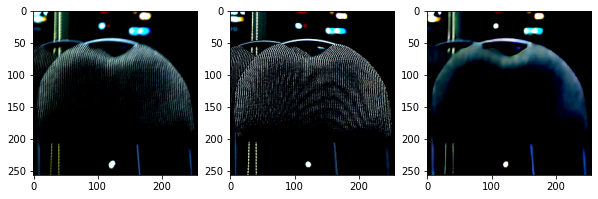

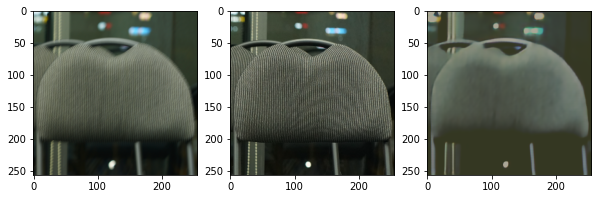

---- -2.811304e-08 ,, 1.0
=====
This is epoch 90
And the PSNR is 22.008792689550752
And the images are...


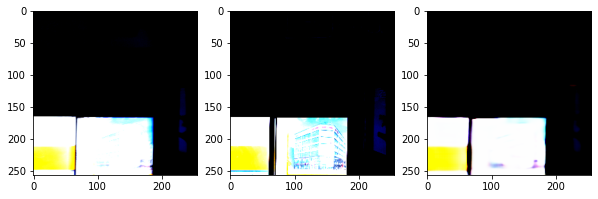

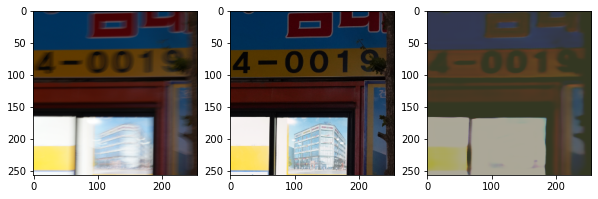

---- -2.811304e-08 ,, 0.97254896
=====
This is epoch 91
And the PSNR is 25.016808435279216
And the images are...


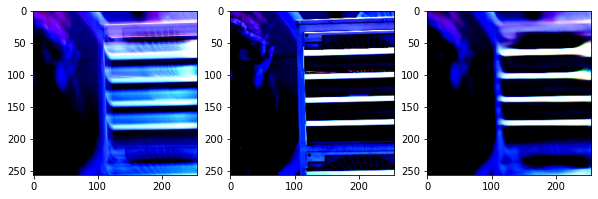

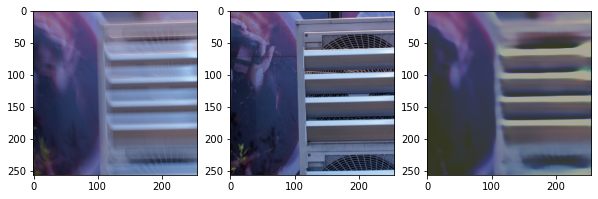

---- 0.019607833 ,, 0.8431372
=====
This is epoch 92
And the PSNR is 22.29446878502933
And the images are...


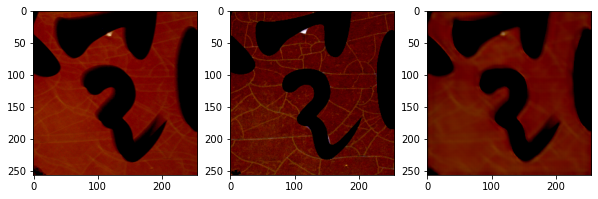

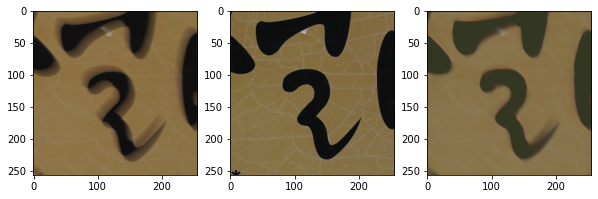

---- -2.811304e-08 ,, 1.0
=====
This is epoch 93
And the PSNR is 19.752091046115904
And the images are...


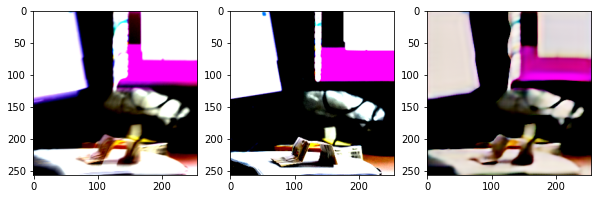

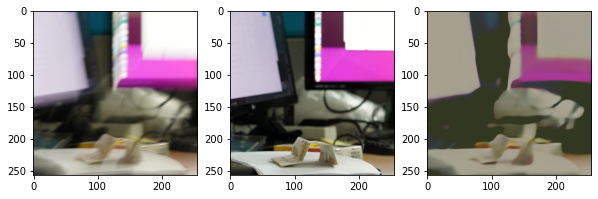

---- 0.0 ,, 1.0
=====
This is epoch 94
And the PSNR is 15.17644568271843
And the images are...


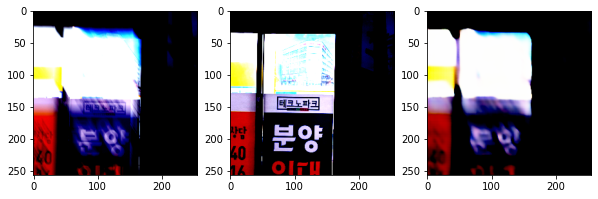

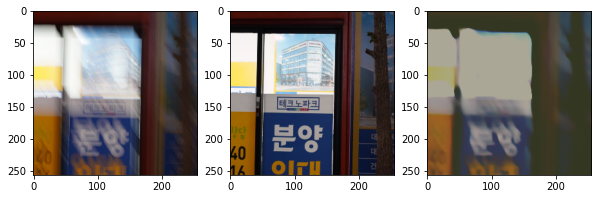

---- -2.811304e-08 ,, 0.63529414
=====
This is epoch 95
And the PSNR is 25.504849853447837
And the images are...


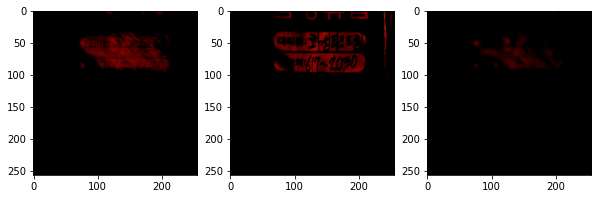

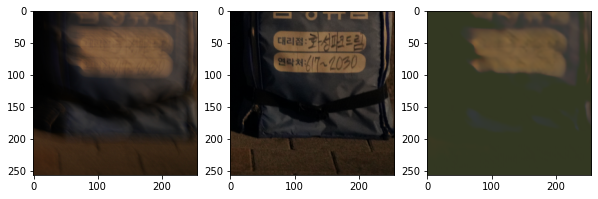

---- 0.011764689 ,, 1.0
=====
This is epoch 96
And the PSNR is 18.383350092004804
And the images are...


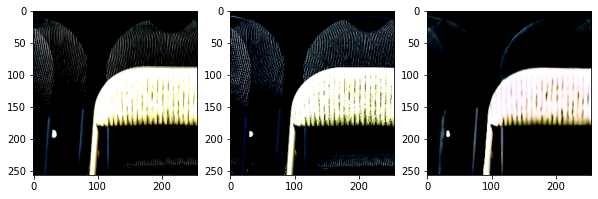

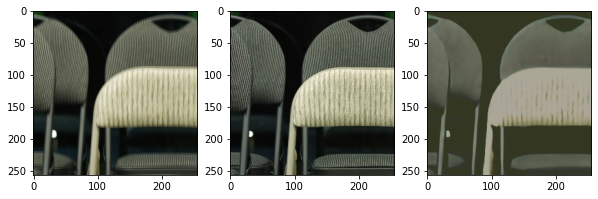

---- 0.0 ,, 1.0
=====
This is epoch 97
And the PSNR is 17.71061946219539
And the images are...


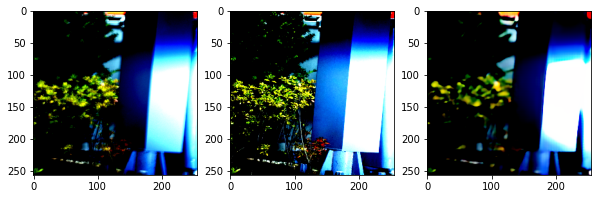

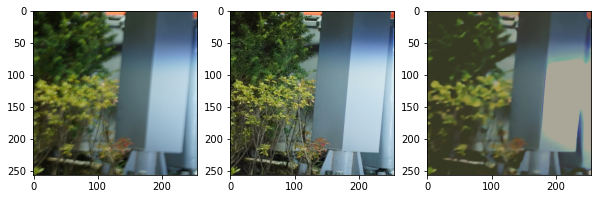

---- 0.0 ,, 1.0
=====
This is epoch 98
And the PSNR is 18.489139716851017
And the images are...


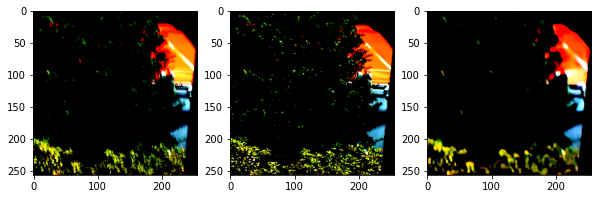

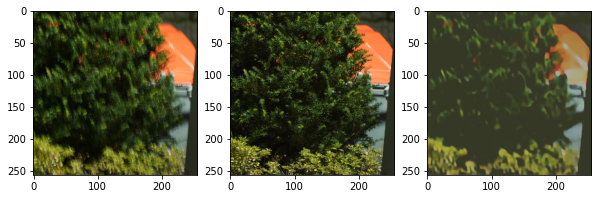

---- -2.811304e-08 ,, 1.0
=====
This is epoch 99
And the PSNR is 23.847018427038687
And the images are...


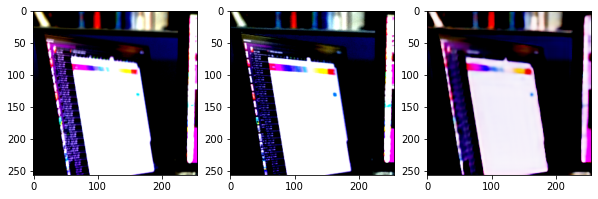

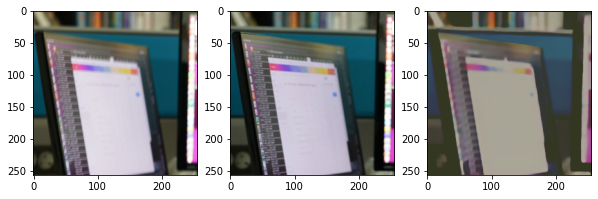

---- -2.811304e-08 ,, 0.98039216
=====
This is epoch 100
And the PSNR is 24.058235900785846
And the images are...


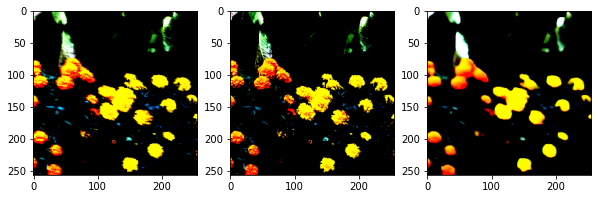

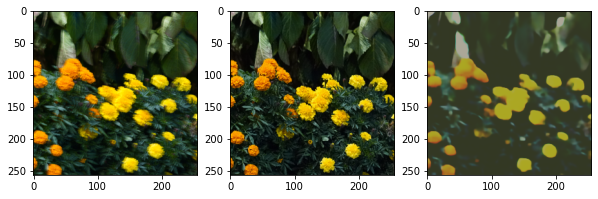

---- 0.0 ,, 0.93725485
=====
This is epoch 101
And the PSNR is 20.120873678316418
And the images are...


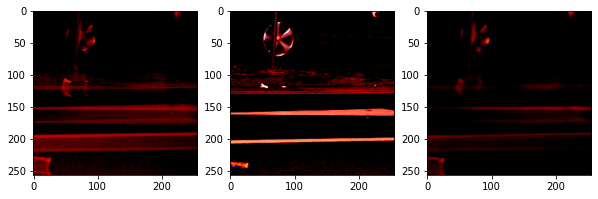

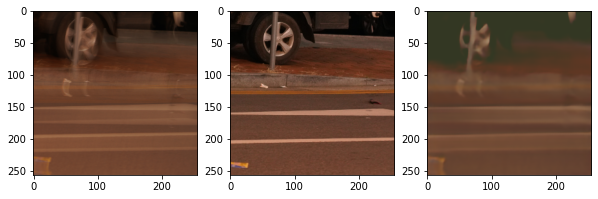

---- -2.811304e-08 ,, 0.98039216
=====
This is epoch 102
And the PSNR is 25.505917756403242
And the images are...


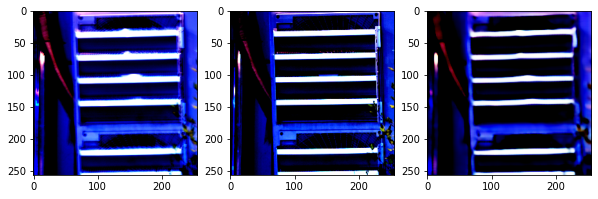

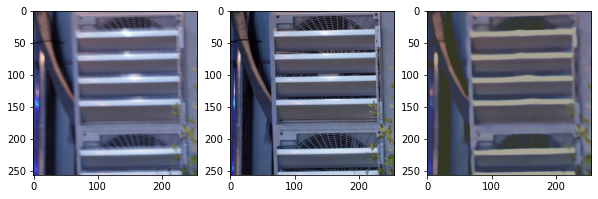

---- -2.6311284e-08 ,, 1.0
=====
This is epoch 103
And the PSNR is 21.97231489874258
And the images are...


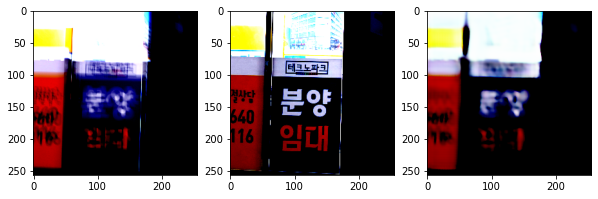

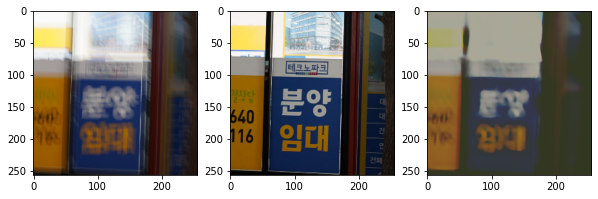

---- 0.015686255 ,, 0.9843136
=====
This is epoch 104
And the PSNR is 20.794996684871435
And the images are...


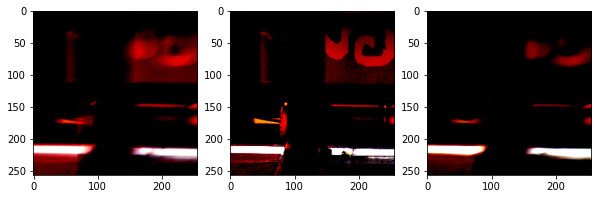

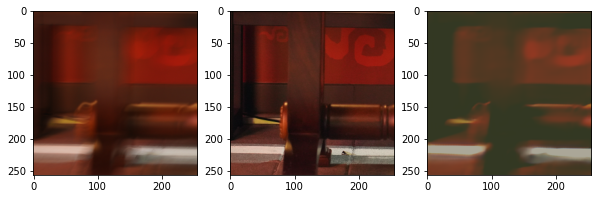

---- -2.6311284e-08 ,, 0.98823535
=====
This is epoch 105
And the PSNR is 25.696714004950508
And the images are...


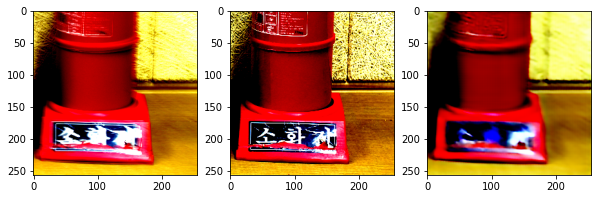

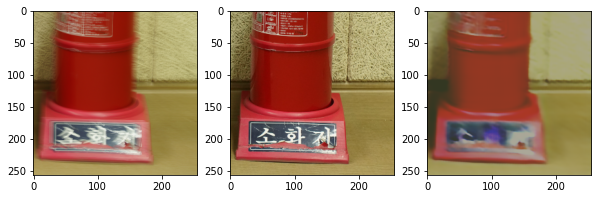

---- -2.811304e-08 ,, 0.9450979
=====
This is epoch 106
And the PSNR is 24.210253038464966
And the images are...


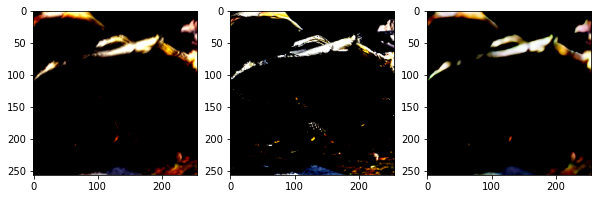

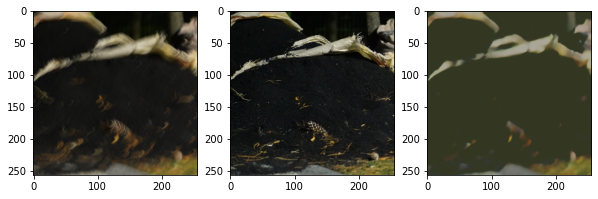

---- -2.811304e-08 ,, 0.63529414
=====
This is epoch 107
And the PSNR is 33.703245039891414
And the images are...


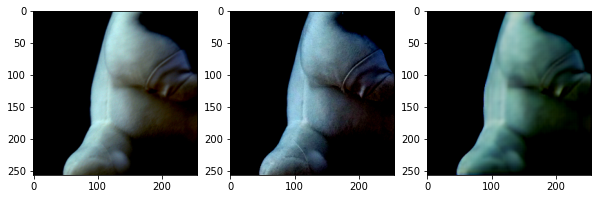

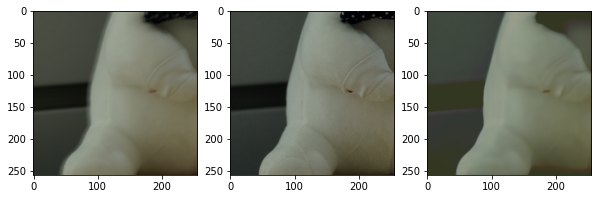

---- -2.6311284e-08 ,, 0.8549019
=====
This is epoch 108
And the PSNR is 28.54501090684227
And the images are...


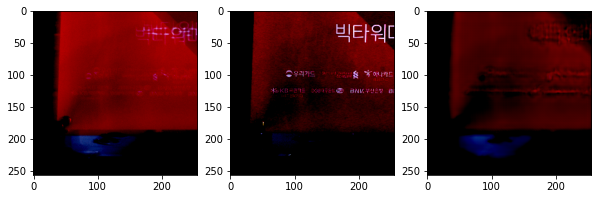

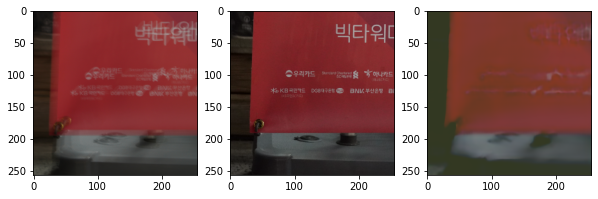

---- 0.0039215502 ,, 0.9686274
=====
This is epoch 109
And the PSNR is 19.95769642847512
And the images are...


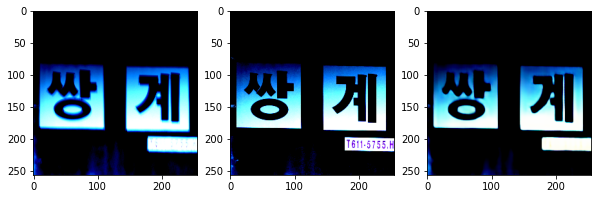

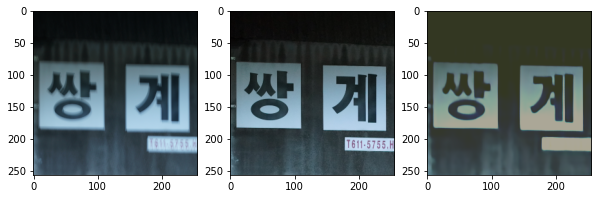

---- 0.015686255 ,, 0.7921568
=====
This is epoch 110
And the PSNR is 28.08472940555859
And the images are...


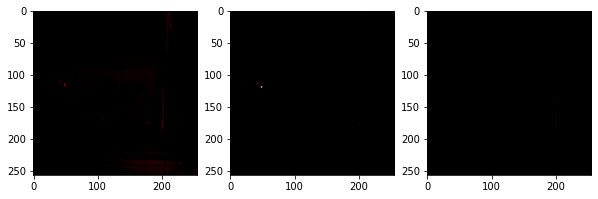

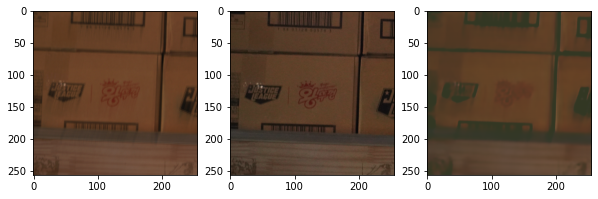

---- -2.811304e-08 ,, 1.0
=====
This is epoch 111
And the PSNR is 25.781784924530207
And the images are...


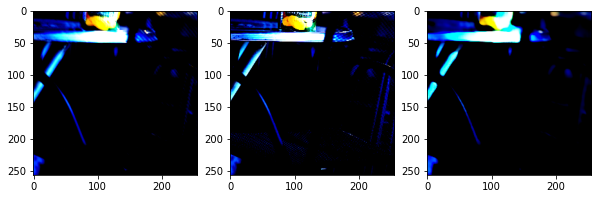

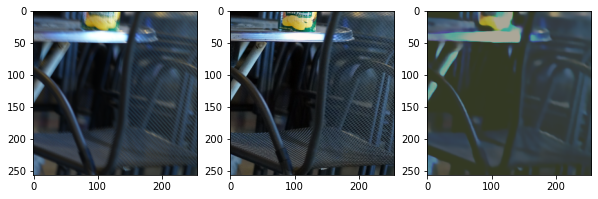

---- -2.6311284e-08 ,, 1.0
=====
This is epoch 112
And the PSNR is 24.48619693460964
And the images are...


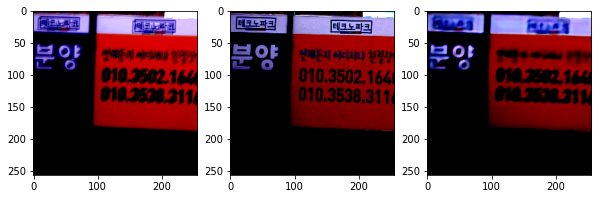

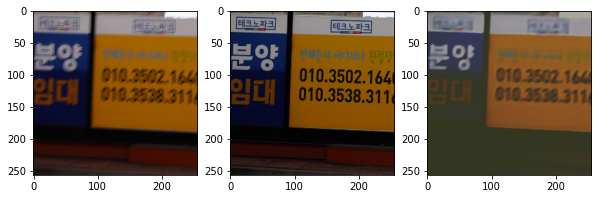

---- 0.0 ,, 0.7960784
=====
This is epoch 113
And the PSNR is 20.400383061450242
And the images are...


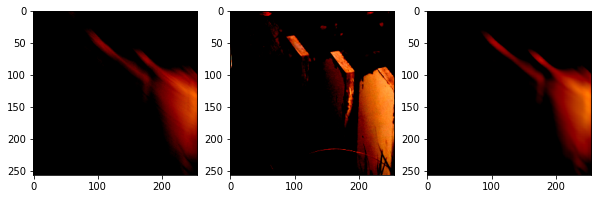

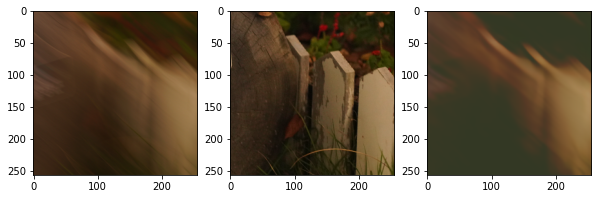

---- -2.6311284e-08 ,, 1.0
=====
This is epoch 114
And the PSNR is 23.239936855149082
And the images are...


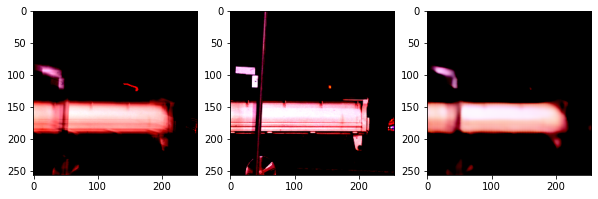

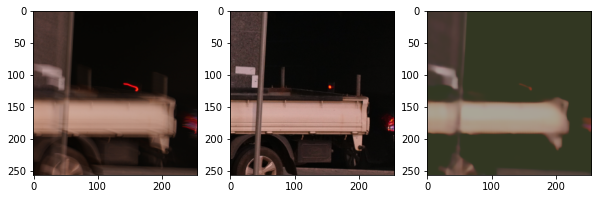

---- -2.811304e-08 ,, 0.98823524
=====
This is epoch 115
And the PSNR is 27.320822638861053
And the images are...


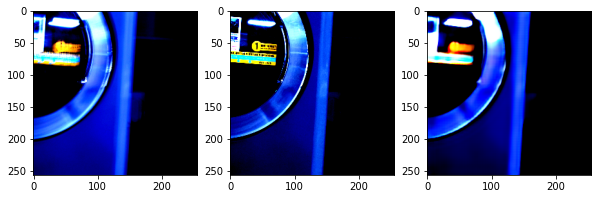

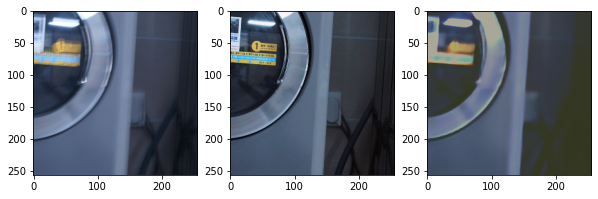

---- -2.811304e-08 ,, 0.68627447
=====
This is epoch 116
And the PSNR is 32.34367576696717
And the images are...


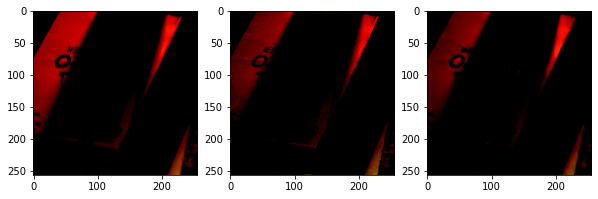

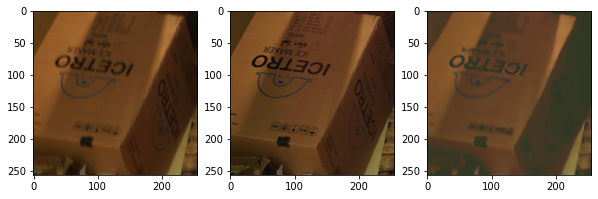

---- -2.811304e-08 ,, 0.9568627
=====
This is epoch 117
And the PSNR is 24.288885685191275
And the images are...


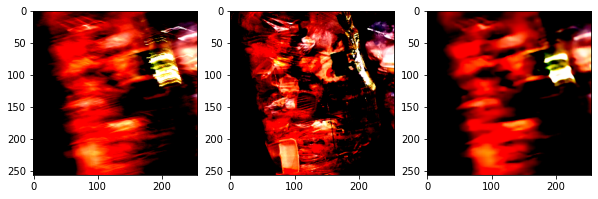

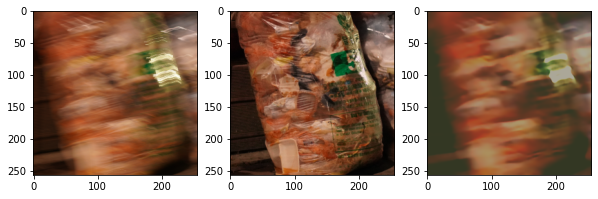

---- -2.811304e-08 ,, 1.0
=====
This is epoch 118
And the PSNR is 27.688504280554987
And the images are...


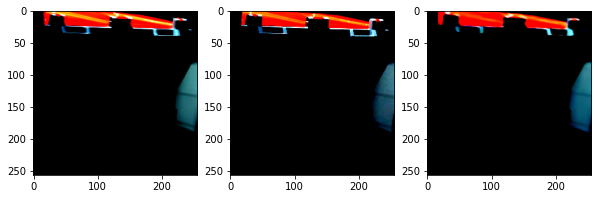

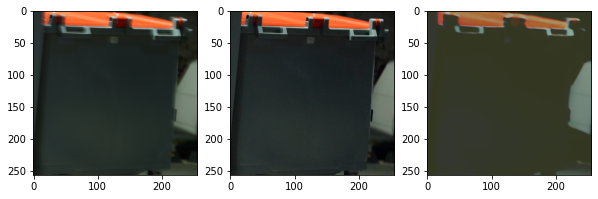

---- -2.811304e-08 ,, 0.5843137
=====
This is epoch 119
And the PSNR is 29.04109878912662
And the images are...


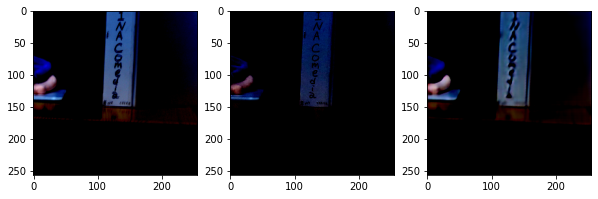

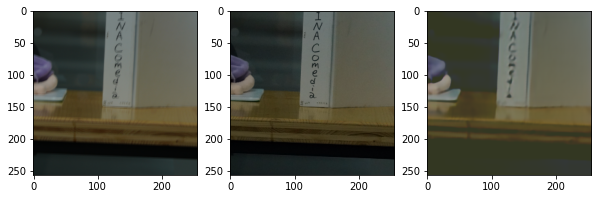

---- 0.011764705 ,, 0.627451
=====
This is epoch 120
And the PSNR is 29.035083282879143
And the images are...


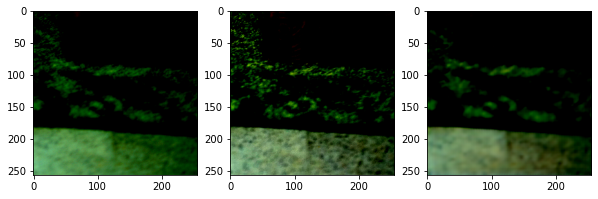

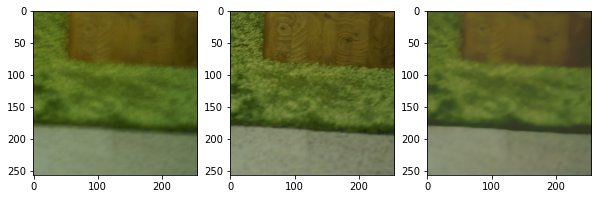

---- 0.0 ,, 1.0
=====
This is epoch 121
And the PSNR is 24.328953116373782
And the images are...


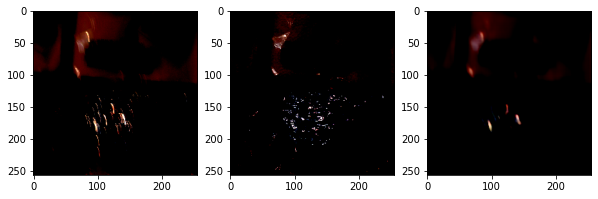

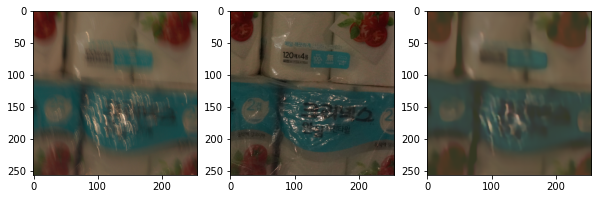

---- -2.6311284e-08 ,, 0.89411765
=====
This is epoch 122
And the PSNR is 26.954465377330273
And the images are...


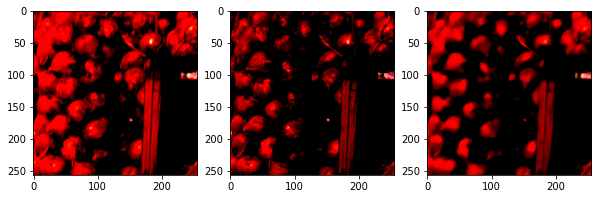

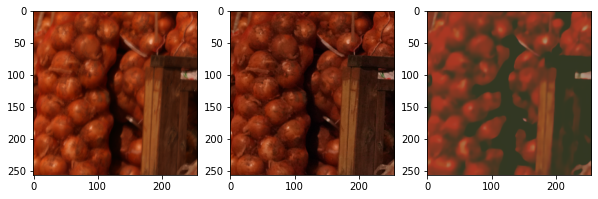

---- 0.04705881 ,, 0.96862745
=====
This is epoch 123
And the PSNR is 19.262312990187212
And the images are...


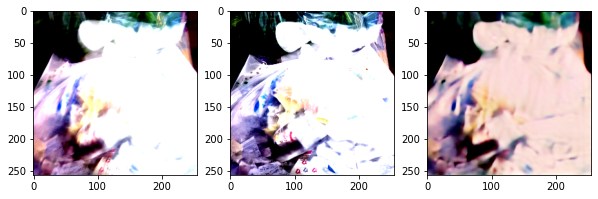

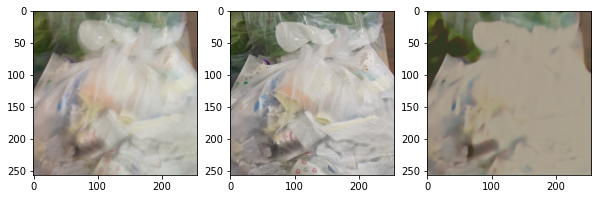

---- -2.811304e-08 ,, 0.9921568
=====
This is epoch 124
And the PSNR is 24.811187442381947
And the images are...


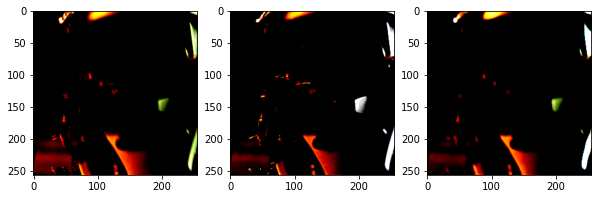

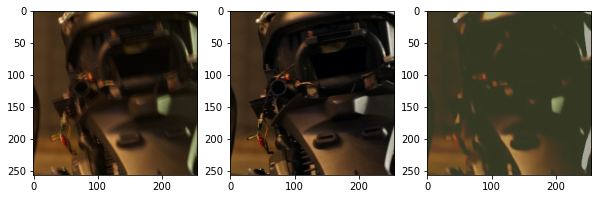

---- 0.0 ,, 0.9529411
=====
This is epoch 125
And the PSNR is 23.921542764625293
And the images are...


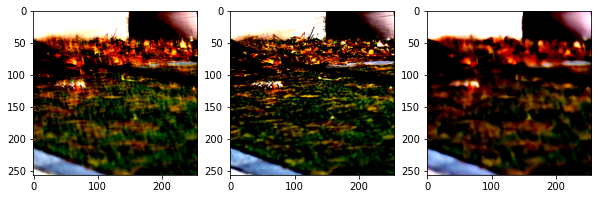

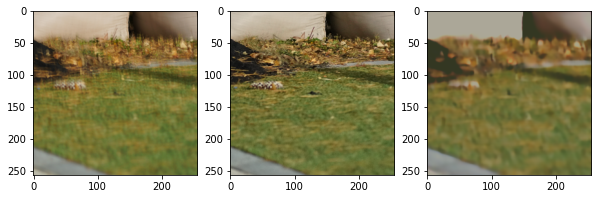

---- 0.0078431275 ,, 0.98823524
=====
This is epoch 126
And the PSNR is 17.342998462582408
And the images are...


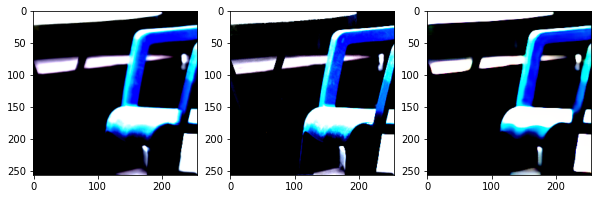

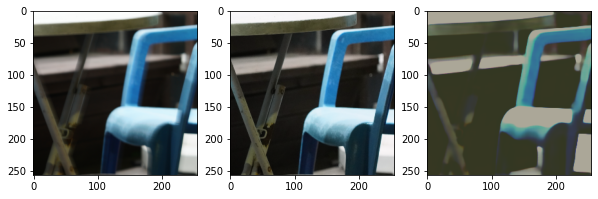

---- -2.811304e-08 ,, 0.9686274
=====
This is epoch 127
And the PSNR is 30.36283306924634
And the images are...


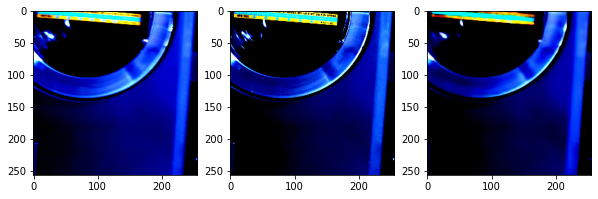

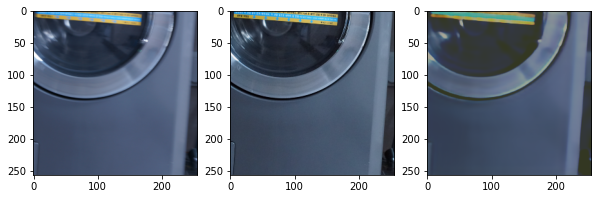

---- 0.0 ,, 1.0
=====
This is epoch 128
And the PSNR is 23.08761080655175
And the images are...


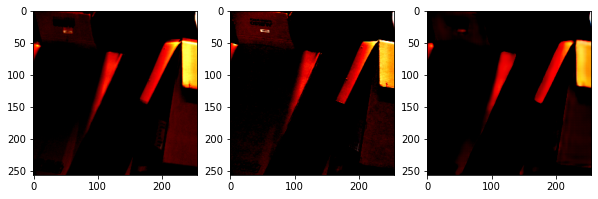

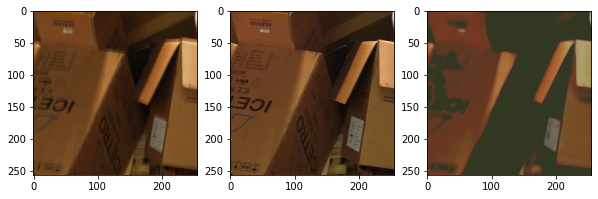

In [ ]:
# dataset = BSD_B_Dataset(path, target_size=target_size)
# dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)
datamodule = BSD_B_DataModule(batch_size=batch_size, target_size=target_size, mean=mean, std=std)

pix2pix = Pix2Pix(3, 3, learning_rate=lr, lambda_recon=lambda_recon, display_step=display_step, mean=mean, std=std)
trainer = pl.Trainer(max_epochs=n_epochs, gpus=1, callbacks=[checkpoint_callback])   # REMEMBER THE GPU
# trainer.fit(pix2pix, dataloader)
trainer.fit(pix2pix, datamodule)